In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!pip install -q git+https://github.com/tensorflow/examples.git

  Preparing metadata (setup.py) ... done


In [7]:
import os
import glob
import cv2
import numpy as np
from matplotlib import pyplot as plt
import math
from pathlib import Path
import re
from skimage import measure
from sklearn.metrics import mean_absolute_error, mean_squared_error, accuracy_score
import matplotlib as mpl
import tqdm
import tensorflow as tf
from tensorflow_examples.models.pix2pix import pix2pix
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import normalize
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.callbacks import LearningRateScheduler
from tensorflow.keras.metrics import MeanIoU
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Conv2DTranspose, BatchNormalization, Dropout, Lambda

In [8]:
wh = os.getcwd()
wh

'/content'

In [9]:
%cd /content

/content


# Data Preproccessing

In [13]:
!unzip People-Clothing-Segmentation.zip

Archive:  People-Clothing-Segmentation.zip
  inflating: jpeg_images/IMAGES/img_0001.jpeg  
  inflating: jpeg_images/IMAGES/img_0002.jpeg  
  inflating: jpeg_images/IMAGES/img_0003.jpeg  
  inflating: jpeg_images/IMAGES/img_0004.jpeg  
  inflating: jpeg_images/IMAGES/img_0005.jpeg  
  inflating: jpeg_images/IMAGES/img_0006.jpeg  
  inflating: jpeg_images/IMAGES/img_0007.jpeg  
  inflating: jpeg_images/IMAGES/img_0008.jpeg  
  inflating: jpeg_images/IMAGES/img_0009.jpeg  
  inflating: jpeg_images/IMAGES/img_0010.jpeg  
  inflating: jpeg_images/IMAGES/img_0011.jpeg  
  inflating: jpeg_images/IMAGES/img_0012.jpeg  
  inflating: jpeg_images/IMAGES/img_0013.jpeg  
  inflating: jpeg_images/IMAGES/img_0014.jpeg  
  inflating: jpeg_images/IMAGES/img_0015.jpeg  
  inflating: jpeg_images/IMAGES/img_0016.jpeg  
  inflating: jpeg_images/IMAGES/img_0017.jpeg  
  inflating: jpeg_images/IMAGES/img_0018.jpeg  
  inflating: jpeg_images/IMAGES/img_0019.jpeg  
  inflating: jpeg_images/IMAGES/img_0020.jpeg

In [31]:
images_path = "/content/png_images/IMAGES"
masks_path = "/content/png_masks/MASKS"

In [32]:
OUTPUT_CHANNELS = 9
classes = {'bg':0, 'accessories': 1,  'bag': 2,  'clothes': 3, 'shoes': 4, 'glasses': 5,  'hair': 6,  'hat': 7,  'skin': 8}
convs = {0: 0, 1: 1, 2: 2, 3: 3, 4: 3, 5: 3, 6: 3, 7: 4, 8: 3, 9: 1, 10: 3, 11: 3, 12: 4, 13: 3, 14: 3, 15: 1, 16: 4, 17: 5, 18: 3, 19: 6, 20: 7, 21: 4, 22: 3, 23: 3, 24: 3, 25: 3, 26: 3, 27: 3, 28: 4, 29: 1, 30: 3, 31: 3, 32: 4, 33: 3, 34: 1, 35: 3, 36: 4, 37: 3, 38: 3, 39: 4, 40: 3, 41: 8, 42: 3, 43: 4, 44: 3, 45: 3, 46: 3, 47: 5, 48: 3, 49: 3, 50: 3, 51: 3, 52: 3, 53: 3, 54: 3, 55: 3, 56: 3, 57: 1, 58: 4}

In [33]:
#Loading Data
def standardize(x):
    x = np.array(x, dtype='float64')
    x -= np.min(x)
    x /= np.percentile(x, 98)
    x[x > 1] = 1
    return x

def preprocessing(img):
    image = np.array(img)
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    image = np.zeros_like(image)
    image[:,:,0] = gray
    image[:,:,1] = gray
    image[:,:,2] = gray
    image = standardize(image)
    return image

In [34]:
images_paths = []
masks_paths = []

for imgname in os.listdir(images_path):
  images_paths.append(os.path.join(images_path,imgname))

for imgname in os.listdir(masks_path):
  masks_paths.append(os.path.join(masks_path,imgname))

In [35]:
print(images_paths[:5])

['/content/png_images/IMAGES/img_0154.png', '/content/png_images/IMAGES/img_0453.png', '/content/png_images/IMAGES/img_0961.png', '/content/png_images/IMAGES/img_0222.png', '/content/png_images/IMAGES/img_0887.png']


In [36]:
print(masks_paths[:5])

['/content/png_masks/MASKS/seg_0272.png', '/content/png_masks/MASKS/seg_0247.png', '/content/png_masks/MASKS/seg_0084.png', '/content/png_masks/MASKS/seg_0578.png', '/content/png_masks/MASKS/seg_0781.png']


In [37]:
images_paths.sort()
masks_paths.sort()

In [38]:
SIZE_X = 256
SIZE_Y = 256
n_classes=9

#Capture training image info as a list
train_images = []
train_masks = []

for imgpath in tqdm.tqdm(images_paths):
  img = cv2.imread(imgpath)
  img = cv2.resize(img, (SIZE_Y, SIZE_X))
  img = preprocessing(img)
  train_images.append(img)


for maskpath in tqdm.tqdm(masks_paths):
  mask0 = cv2.imread(maskpath, 0)
  mask1 = cv2.resize(mask0, (SIZE_Y, SIZE_X), interpolation = cv2.INTER_NEAREST)
  for oldnum in range(0,59):
      new_num = convs[oldnum]
      mask1[mask1==oldnum]=new_num
  train_masks.append(mask1)

train_images = np.array(train_images)
train_masks = np.array(train_masks)

X_train, X_val, y_train, y_val = train_test_split(train_images, train_masks, test_size = 0.10, shuffle=True, random_state = 1)
print("Class values: ", np.unique(y_train))

100%|██████████| 1000/1000 [00:02<00:00, 371.91it/s]


Class values:  [0 1 2 3 4 5 6 7 8]


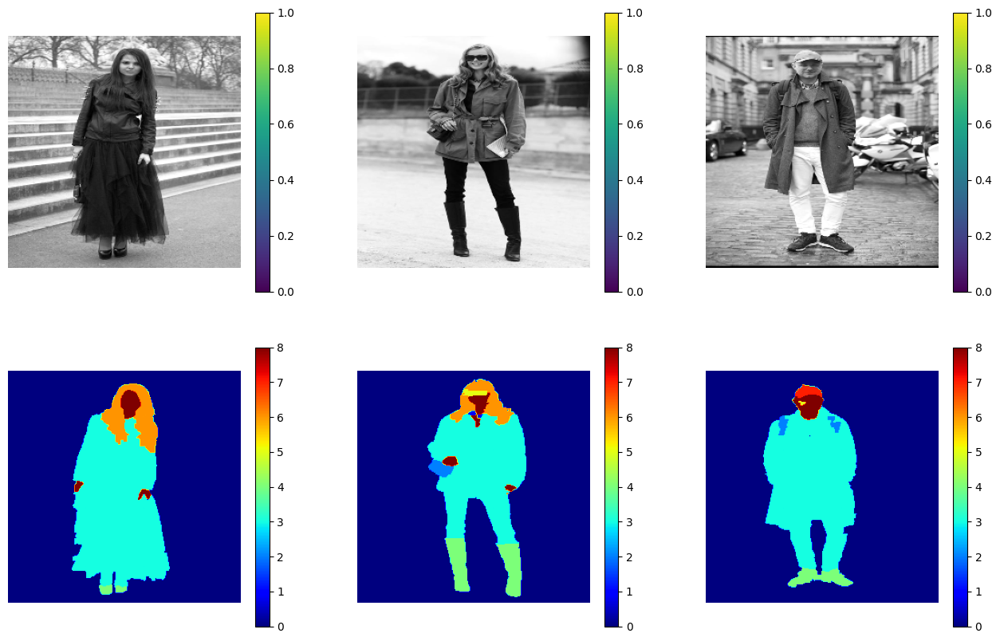

In [39]:
NORM = mpl.colors.Normalize(vmin=0, vmax=8)

plt.figure(figsize=(16,10))
for i in range(1,4):
    plt.subplot(2,3,i)
    img = train_images[i]
    plt.imshow(img)
    plt.colorbar()
    plt.axis('off')

for i in range(4,7):
    plt.subplot(2,3,i)
    img = np.squeeze(train_masks[i-3])
    plt.imshow(img, cmap='jet', norm=NORM)
    plt.colorbar()
    plt.axis('off')
plt.show()

# Define Model

In [40]:
def unet_model(output_channels):
    IMG_HEIGHT = X_train.shape[1]
    IMG_WIDTH  = X_train.shape[2]
    IMG_CHANNELS = X_train.shape[3]

    base_model = MobileNetV2(input_shape=[IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS], include_top=False)

    # Using the activations of these layers
    layer_names = [
        'block_1_expand_relu',   # 64x64
        'block_3_expand_relu',   # 32x32
        'block_6_expand_relu',   # 16x16
        'block_13_expand_relu',  # 8x8
        'block_16_project',      # 4x4
    ]

    base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

    # Creating the feature extraction model
    down_stack = Model(inputs=base_model.input, outputs=base_model_outputs)

    down_stack.trainable = False

    up_stack = [
        pix2pix.upsample(512, 3),  # 4x4 -> 8x8
        pix2pix.upsample(256, 3),  # 8x8 -> 16x16
        pix2pix.upsample(128, 3),  # 16x16 -> 32x32
        pix2pix.upsample(64, 3),   # 32x32 -> 64x64
    ]

    inputs = Input(shape=[IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = Concatenate()
        x = concat([x, skip])

    last = Conv2DTranspose(OUTPUT_CHANNELS, 3, strides=2, padding='same')  #64x64 -> 128x128

    x = last(x)

    return Model(inputs=inputs, outputs=x)

In [41]:
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = pred_mask[..., tf.newaxis]
    return pred_mask[0]


def show_predictions(epoch, dataset=None, num=50):
  if dataset:

    for image, mask in dataset.take(num):
        pred_mask = model.predict(image)
        plt.figure(figsize=(15, 10))
        plt.subplot(231)
        plt.title('Testing Image')
        plt.imshow(image[0], cmap='gray')
        plt.subplot(232)
        plt.title('Ground Truth')
        plt.imshow(mask[0], cmap='jet')
        plt.subplot(233)
        plt.title('Prediction on test image')
        plt.imshow(create_mask(pred_mask), cmap='jet')

        plt.savefig(f"results/mask_{str(ii)}.png")

        plt.show()
  else:
      fig = plt.figure(figsize=(12, 12))
      fig.suptitle(f"\n Epoch: {str(epoch)}\n", fontsize=16)

      plt.subplot(331)
      plt.title('Testing Image')
      plt.imshow(train_images[num], cmap='gray')
      plt.subplot(332)
      plt.title('Ground Truth')
      plt.imshow(train_masks[num], cmap='jet')
      plt.subplot(333)
      plt.title('Prediction on test image')
      plt.imshow(create_mask(model.predict(train_images[num][tf.newaxis, ...]))[:,:,0], cmap='jet')

      plt.subplot(334)
      plt.imshow(train_images[num+16], cmap='gray')
      plt.subplot(335)
      plt.imshow(train_masks[num+16], cmap='jet')
      plt.subplot(336)
      plt.imshow(create_mask(model.predict(train_images[num+16][tf.newaxis, ...]))[:,:,0], cmap='jet')
      plt.subplot(337)
      plt.imshow(train_images[num+14], cmap='gray')
      plt.subplot(338)
      plt.imshow(train_masks[num+14], cmap='jet')
      plt.subplot(339)
      plt.imshow(create_mask(model.predict(train_images[num+14][tf.newaxis, ...]))[:,:,0], cmap='jet')

      #plt.savefig(f"results/mask_{str(num+100)}_{str(epoch)}.png")

      plt.show()

In [42]:
model = unet_model(OUTPUT_CHANNELS)
model.compile(optimizer='adam',
              loss=SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

metrics=[tf.keras.metrics.MeanIoU(num_classes=9)]

9406464/9406464 [==============================] - 0s 0us/step


# Train

Epoch 1/50
1/1 [==============================] - 0s 36ms/step


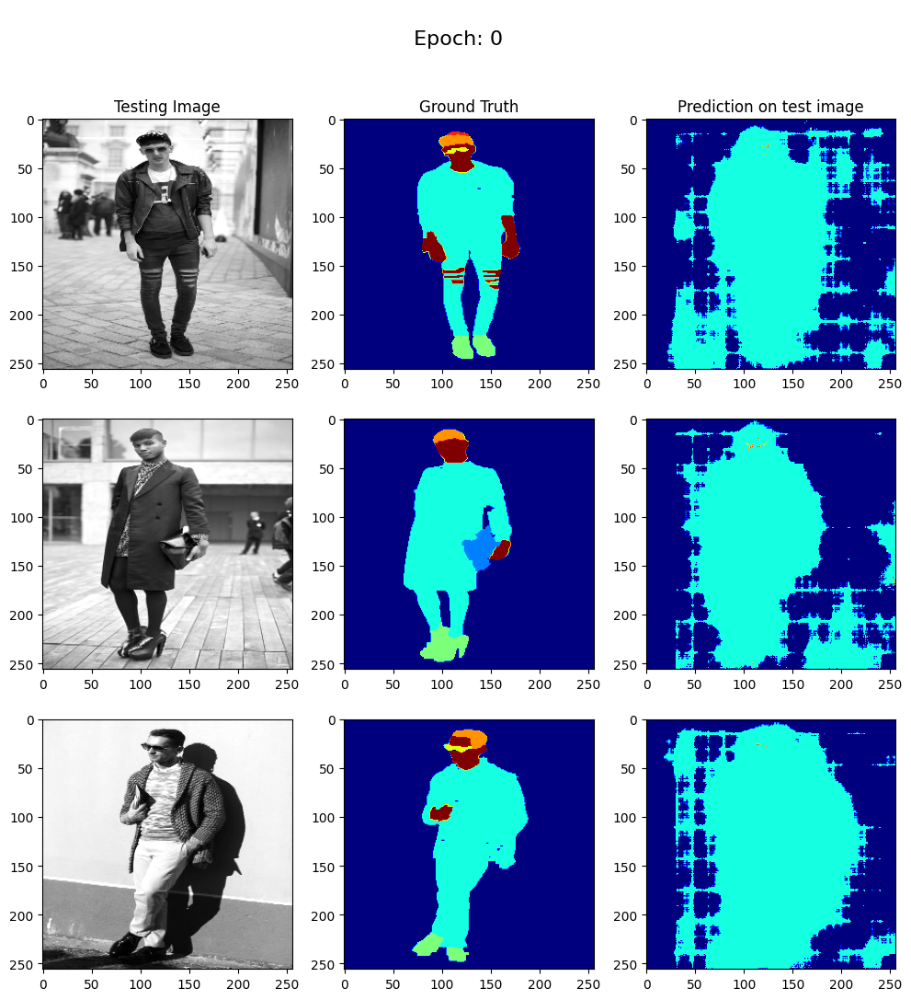


Sample Prediction after epoch 1

57/57 [==============================] - 29s 266ms/step - loss: 0.5606 - accuracy: 0.8472 - val_loss: 1.6199 - val_accuracy: 0.6823
Epoch 2/50
1/1 [==============================] - 0s 28ms/step


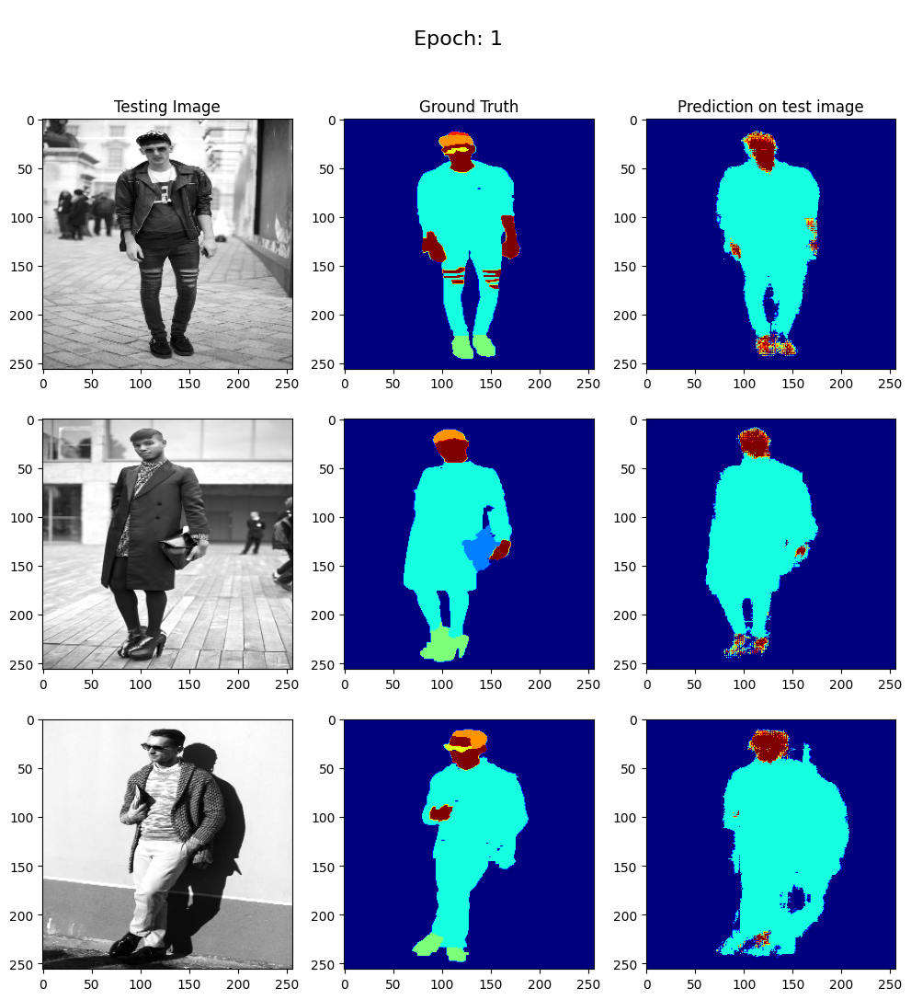


Sample Prediction after epoch 2

57/57 [==============================] - 8s 142ms/step - loss: 0.2508 - accuracy: 0.9253 - val_loss: 0.2386 - val_accuracy: 0.9255
Epoch 3/50
1/1 [==============================] - 0s 21ms/step


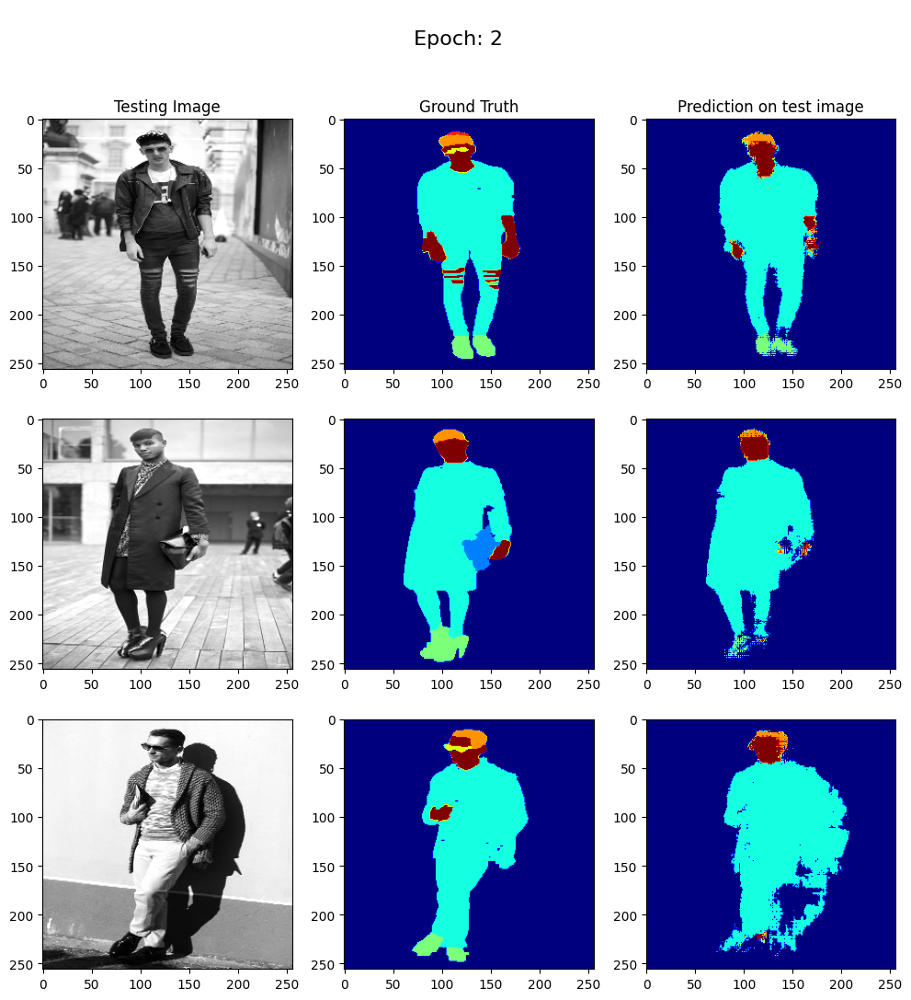


Sample Prediction after epoch 3

57/57 [==============================] - 9s 151ms/step - loss: 0.1953 - accuracy: 0.9412 - val_loss: 0.2006 - val_accuracy: 0.9370
Epoch 4/50
1/1 [==============================] - 0s 22ms/step


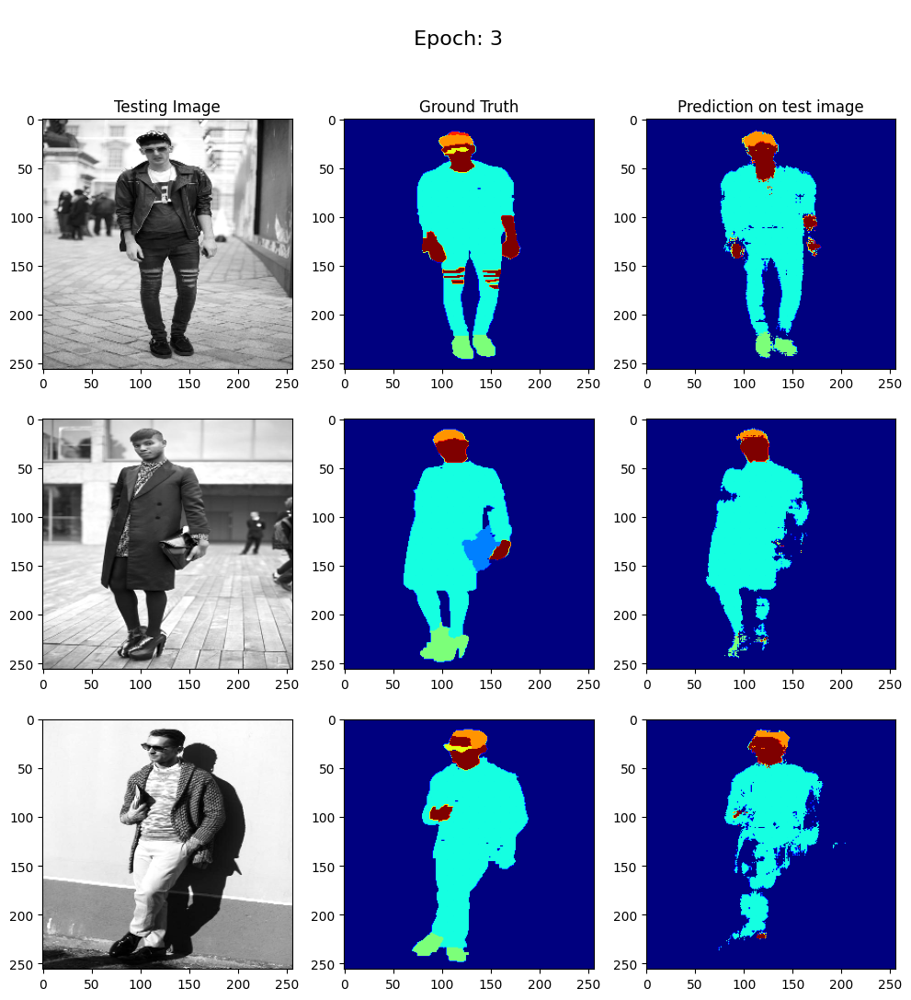


Sample Prediction after epoch 4

57/57 [==============================] - 8s 144ms/step - loss: 0.1564 - accuracy: 0.9513 - val_loss: 0.2320 - val_accuracy: 0.9226
Epoch 5/50
1/1 [==============================] - 0s 22ms/step


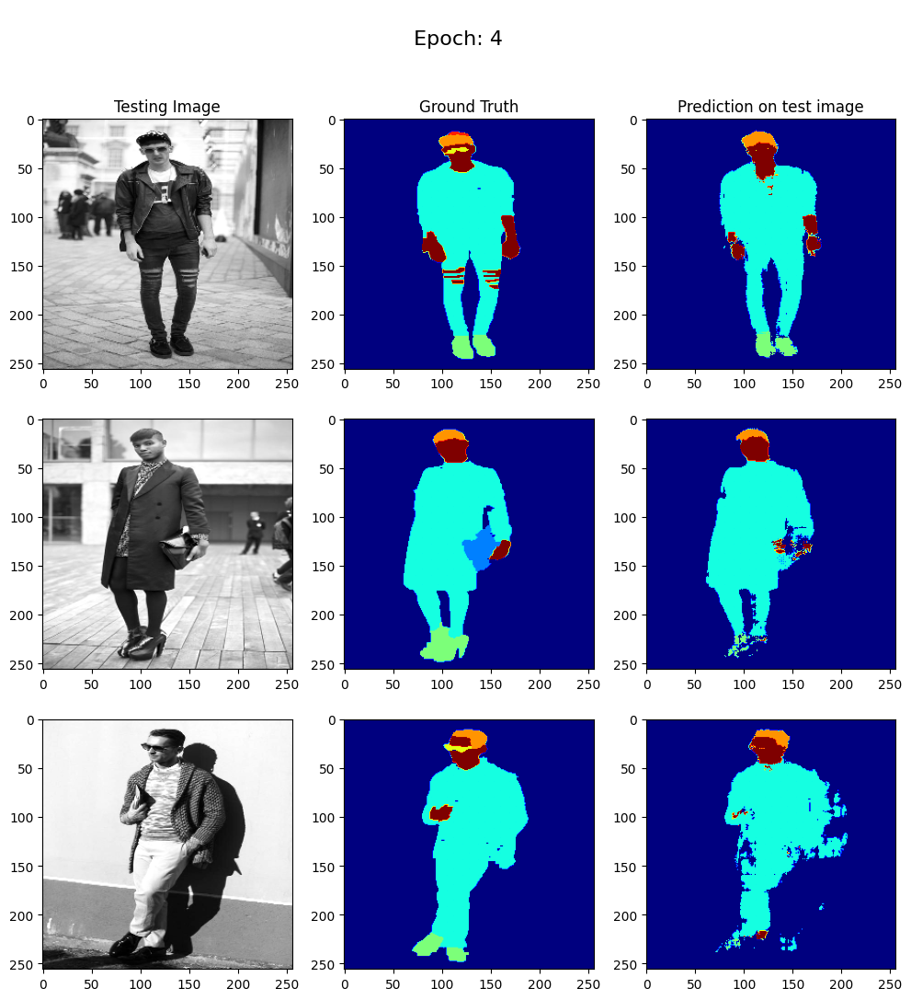


Sample Prediction after epoch 5

57/57 [==============================] - 9s 152ms/step - loss: 0.1354 - accuracy: 0.9559 - val_loss: 0.1685 - val_accuracy: 0.9441
Epoch 6/50
1/1 [==============================] - 0s 33ms/step


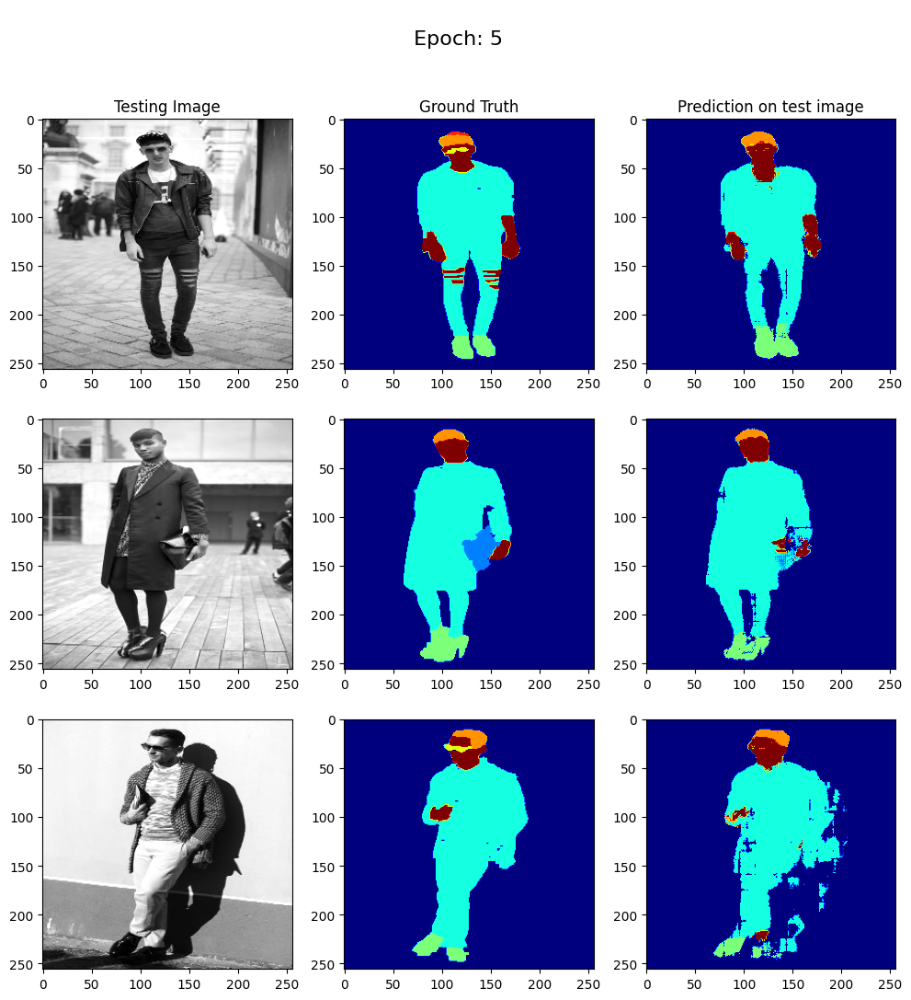


Sample Prediction after epoch 6

57/57 [==============================] - 10s 168ms/step - loss: 0.1227 - accuracy: 0.9590 - val_loss: 0.1564 - val_accuracy: 0.9475
Epoch 7/50
1/1 [==============================] - 0s 24ms/step


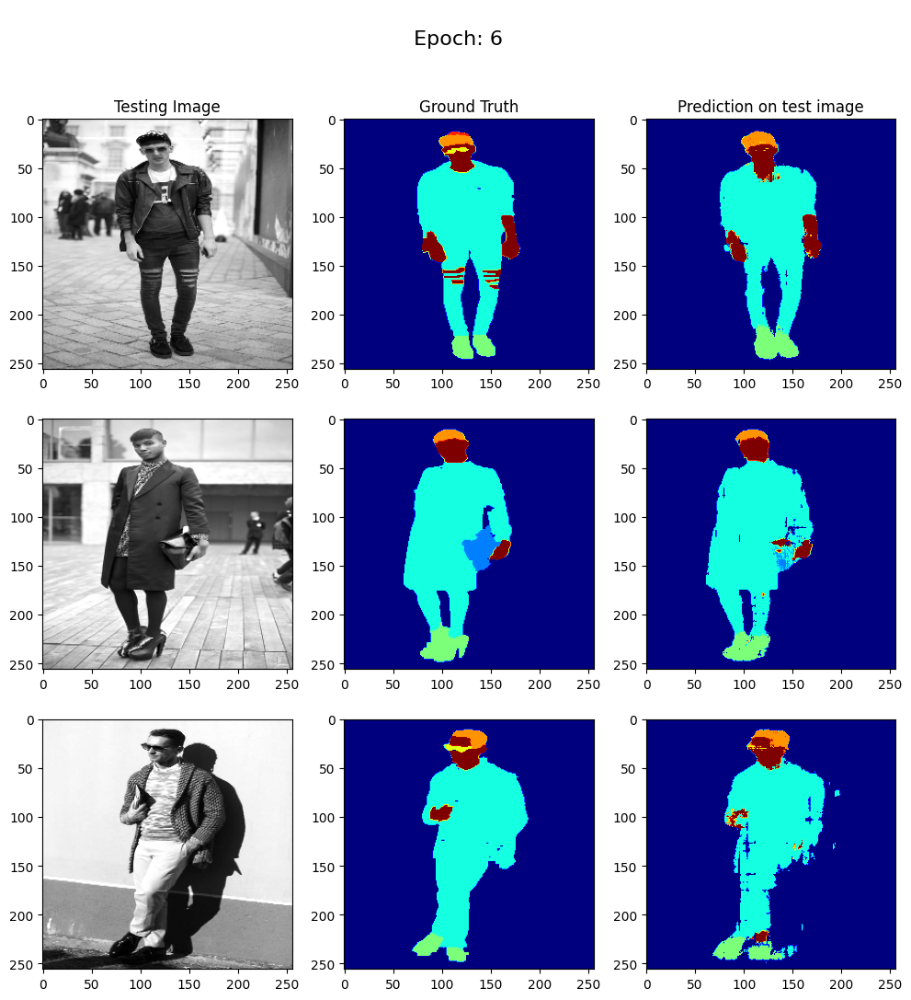


Sample Prediction after epoch 7

57/57 [==============================] - 8s 146ms/step - loss: 0.1129 - accuracy: 0.9618 - val_loss: 0.1421 - val_accuracy: 0.9520
Epoch 8/50
1/1 [==============================] - 0s 23ms/step


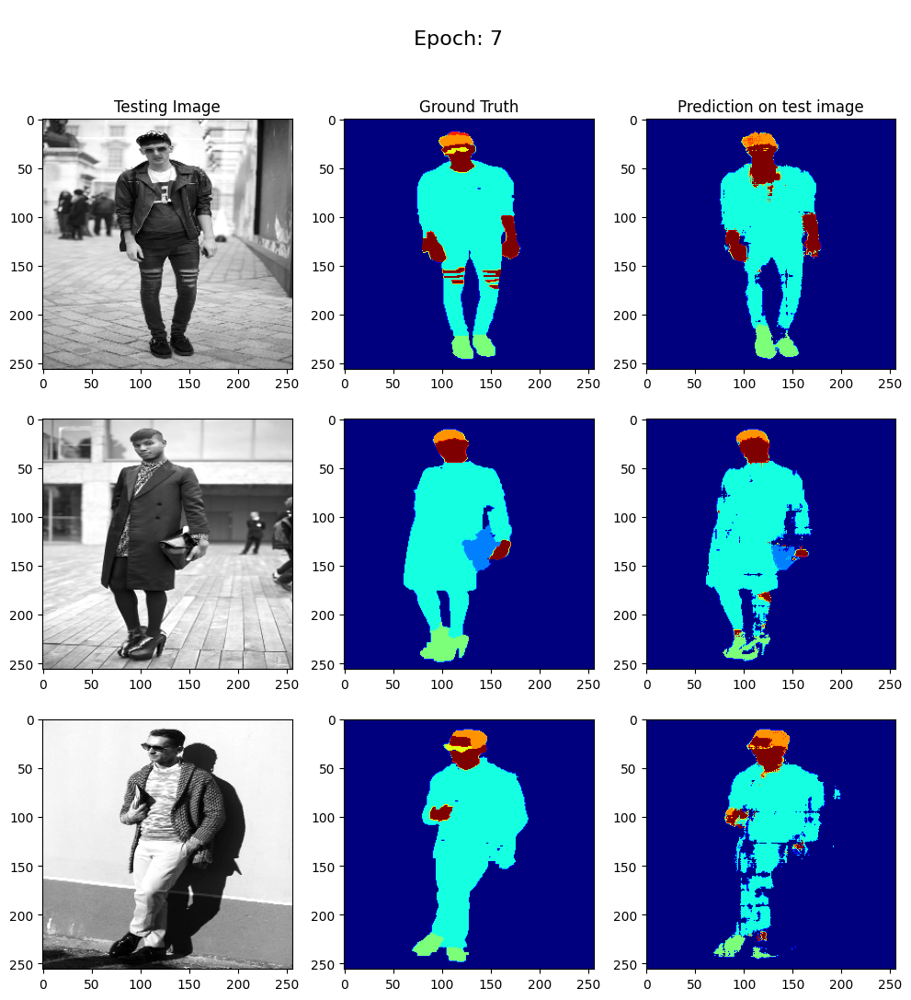


Sample Prediction after epoch 8

57/57 [==============================] - 9s 153ms/step - loss: 0.1068 - accuracy: 0.9634 - val_loss: 0.1772 - val_accuracy: 0.9382
Epoch 9/50
1/1 [==============================] - 0s 49ms/step


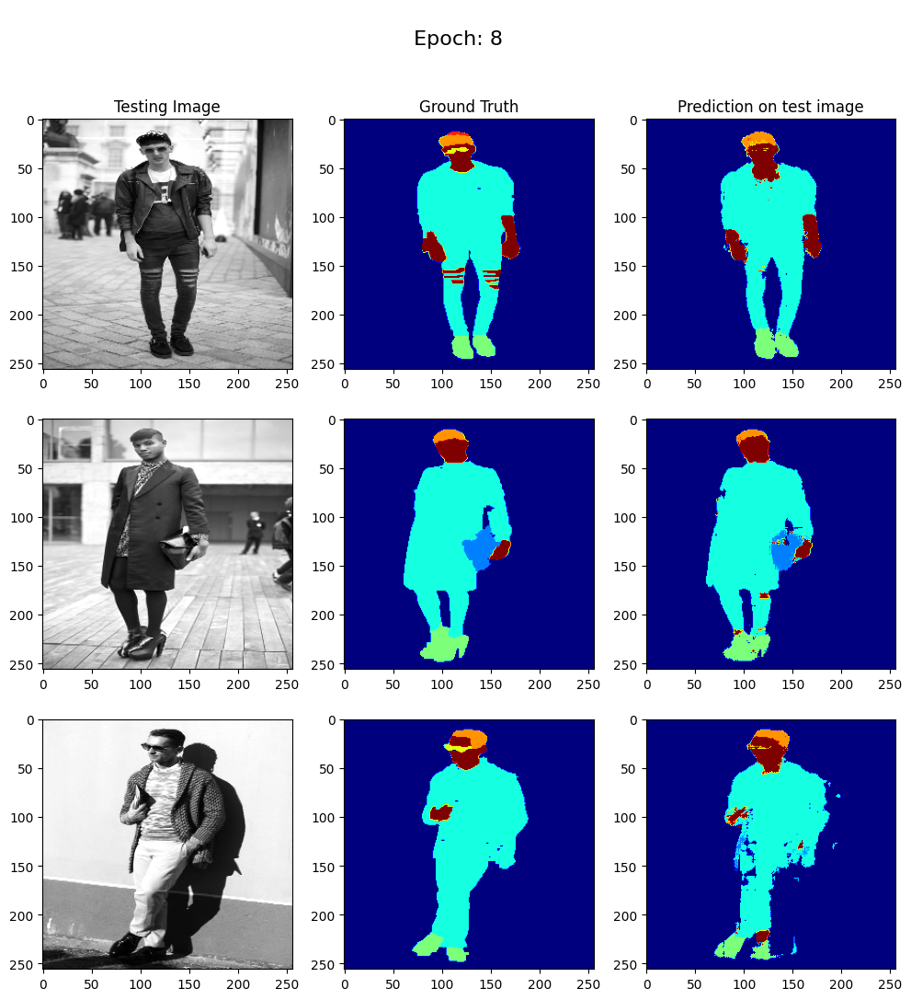


Sample Prediction after epoch 9

57/57 [==============================] - 9s 166ms/step - loss: 0.1026 - accuracy: 0.9646 - val_loss: 0.1432 - val_accuracy: 0.9508
Epoch 10/50
1/1 [==============================] - 0s 22ms/step


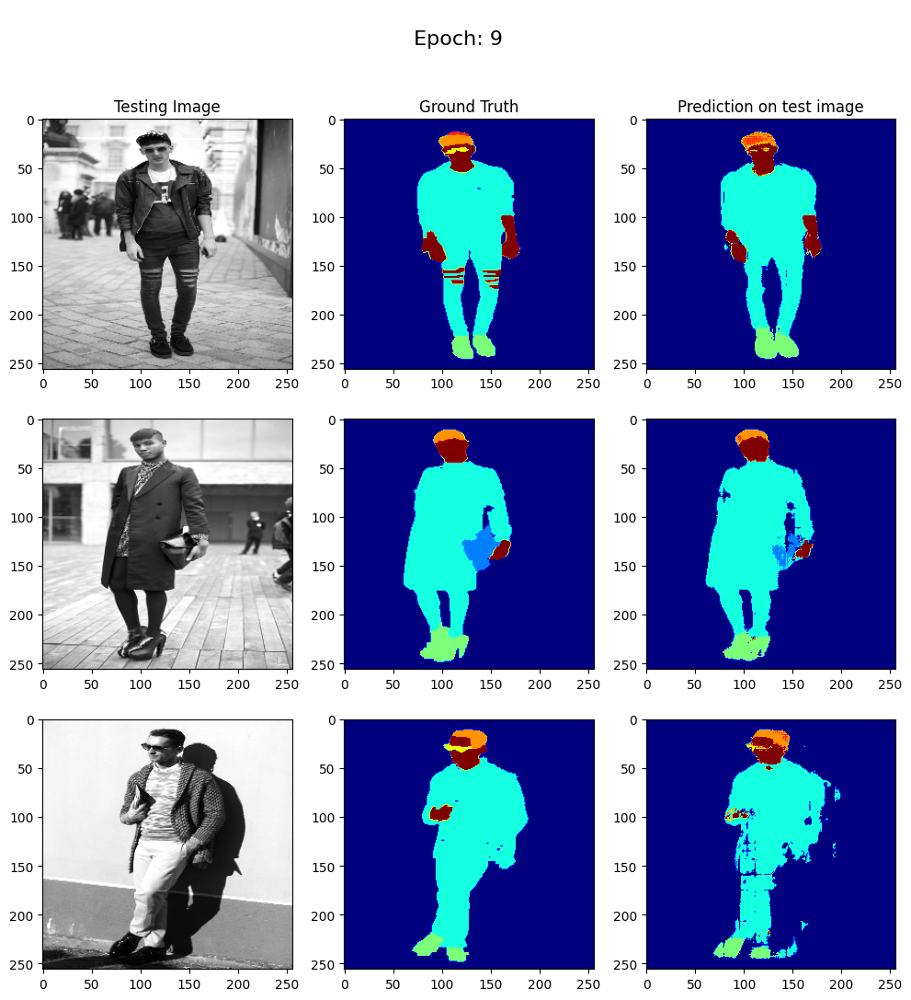


Sample Prediction after epoch 10

57/57 [==============================] - 9s 153ms/step - loss: 0.0939 - accuracy: 0.9675 - val_loss: 0.1407 - val_accuracy: 0.9525
Epoch 11/50
1/1 [==============================] - 0s 23ms/step


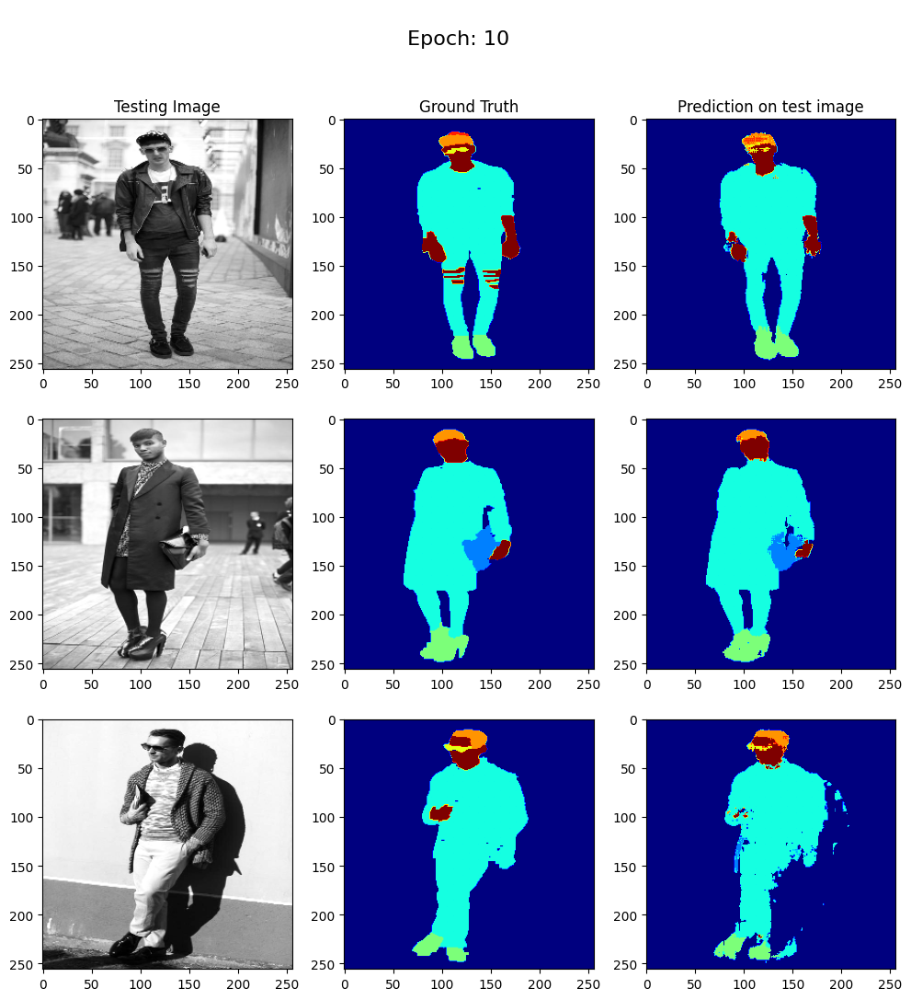


Sample Prediction after epoch 11

57/57 [==============================] - 9s 162ms/step - loss: 0.0874 - accuracy: 0.9697 - val_loss: 0.1440 - val_accuracy: 0.9514
Epoch 12/50
1/1 [==============================] - 0s 32ms/step


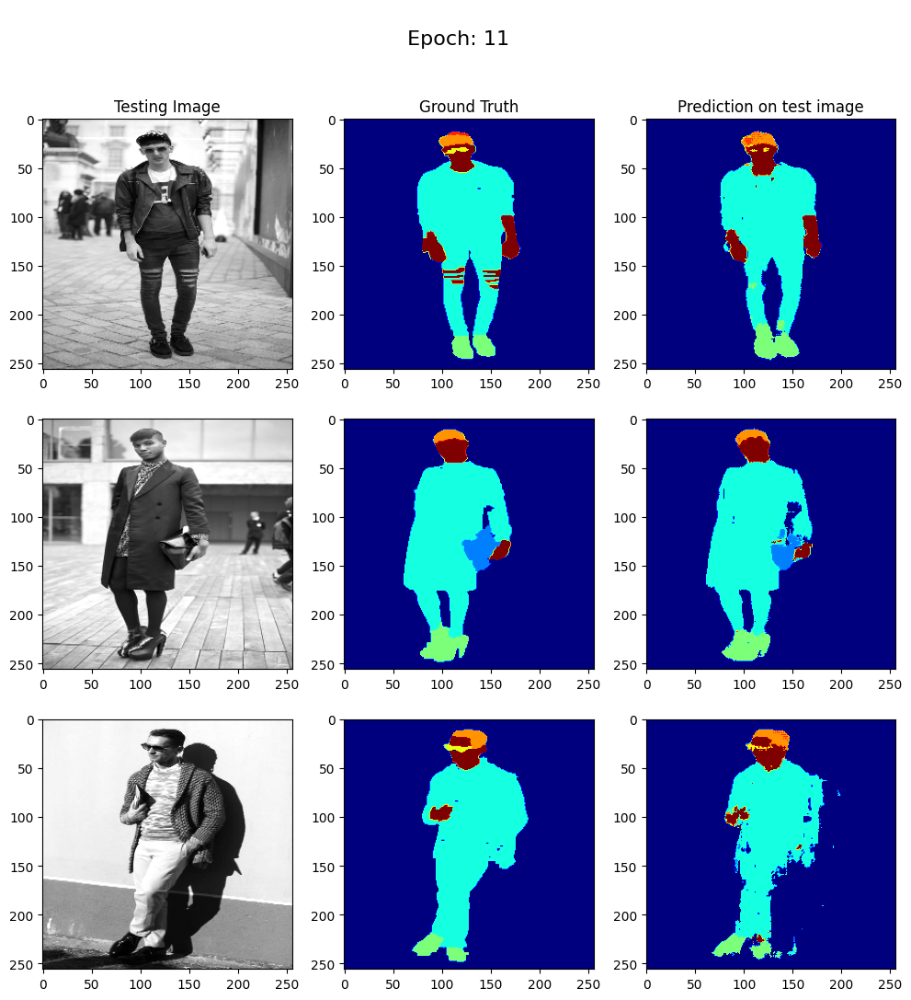


Sample Prediction after epoch 12

57/57 [==============================] - 9s 161ms/step - loss: 0.0832 - accuracy: 0.9711 - val_loss: 0.1555 - val_accuracy: 0.9496
Epoch 13/50
1/1 [==============================] - 0s 24ms/step


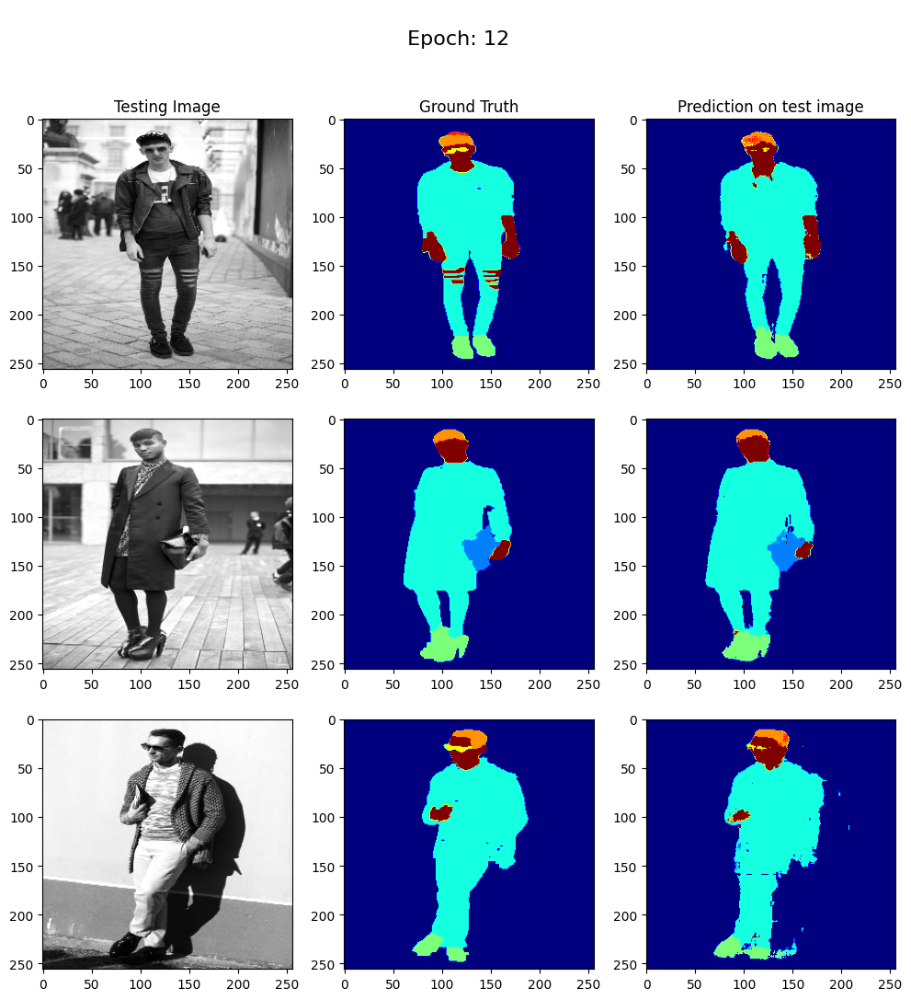


Sample Prediction after epoch 13

57/57 [==============================] - 9s 152ms/step - loss: 0.0777 - accuracy: 0.9730 - val_loss: 0.1354 - val_accuracy: 0.9549
Epoch 14/50
1/1 [==============================] - 0s 31ms/step


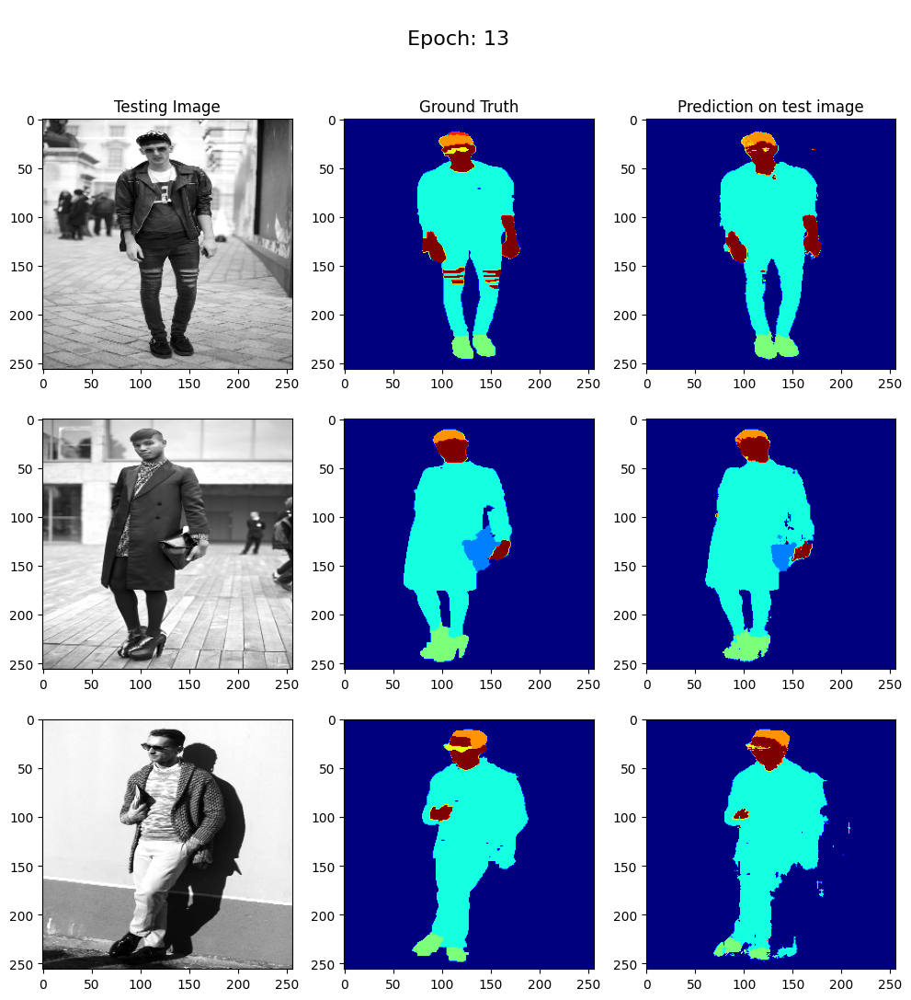


Sample Prediction after epoch 14

57/57 [==============================] - 9s 159ms/step - loss: 0.0744 - accuracy: 0.9739 - val_loss: 0.1407 - val_accuracy: 0.9552
Epoch 15/50
1/1 [==============================] - 0s 34ms/step


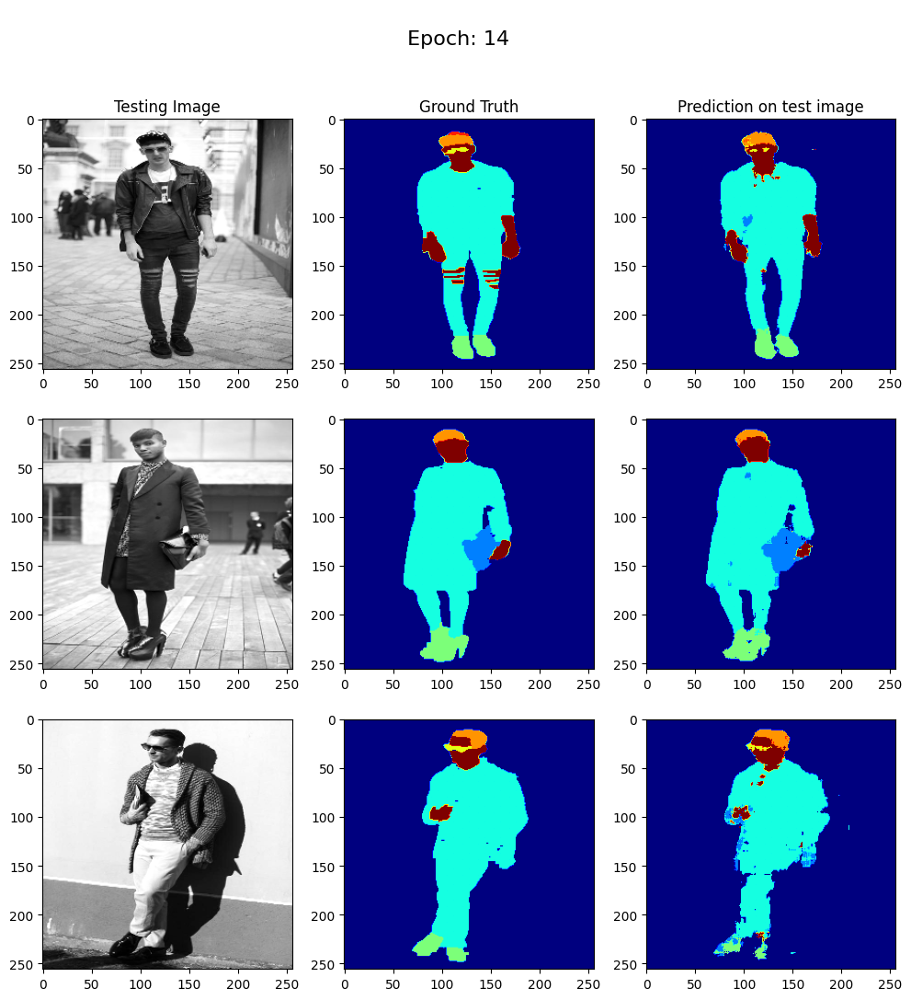


Sample Prediction after epoch 15

57/57 [==============================] - 9s 165ms/step - loss: 0.0688 - accuracy: 0.9759 - val_loss: 0.1655 - val_accuracy: 0.9460
Epoch 16/50
1/1 [==============================] - 0s 31ms/step


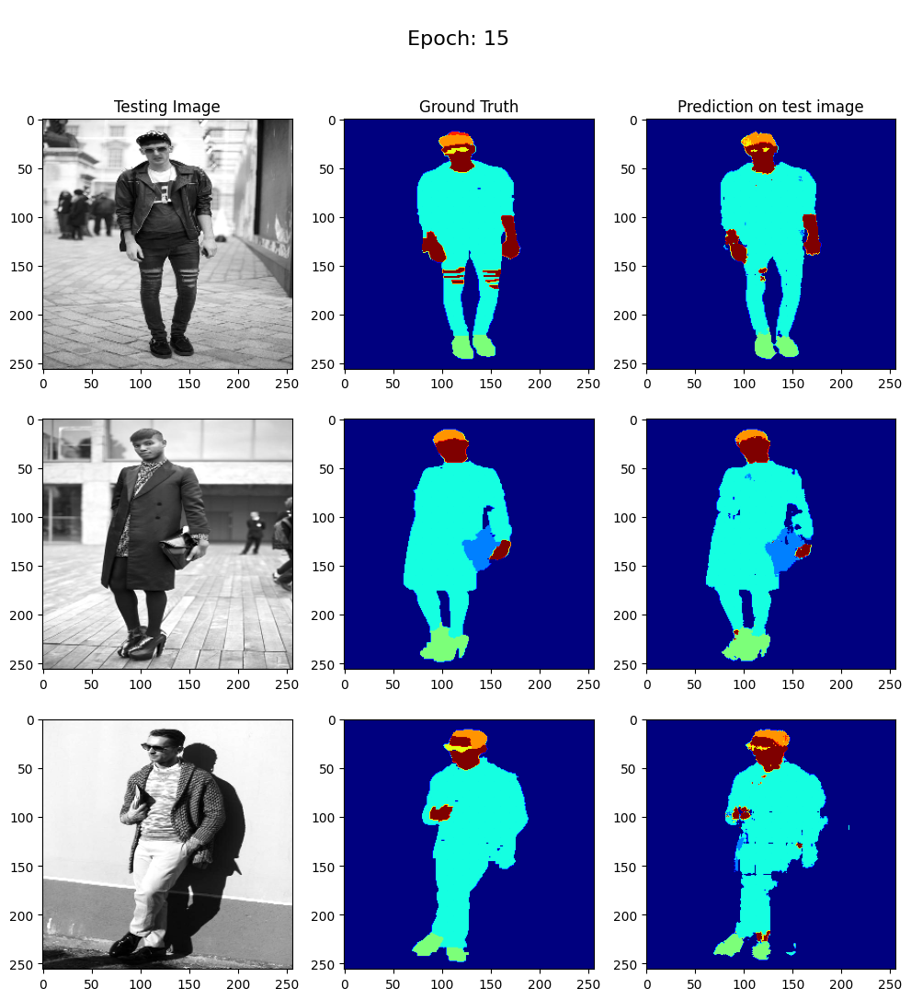


Sample Prediction after epoch 16

57/57 [==============================] - 9s 165ms/step - loss: 0.0667 - accuracy: 0.9766 - val_loss: 0.1634 - val_accuracy: 0.9475
Epoch 17/50
1/1 [==============================] - 0s 45ms/step


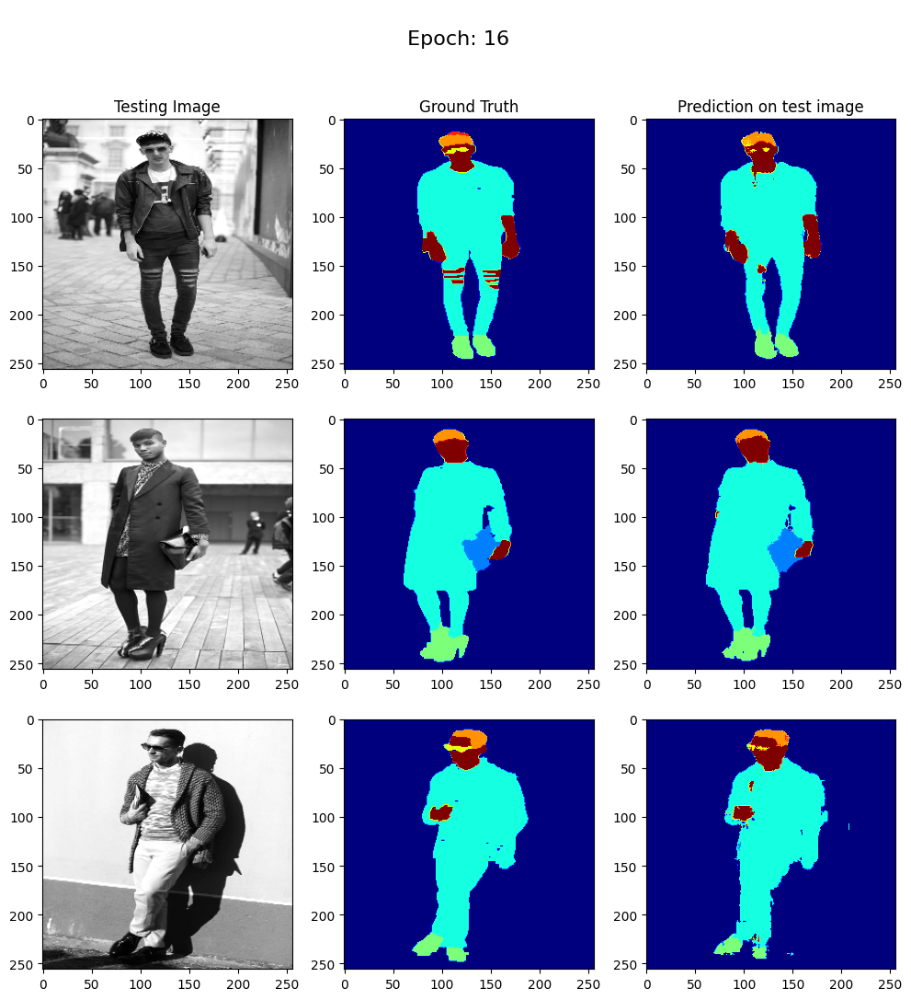


Sample Prediction after epoch 17

57/57 [==============================] - 9s 166ms/step - loss: 0.0614 - accuracy: 0.9784 - val_loss: 0.1437 - val_accuracy: 0.9545
Epoch 18/50
1/1 [==============================] - 0s 32ms/step


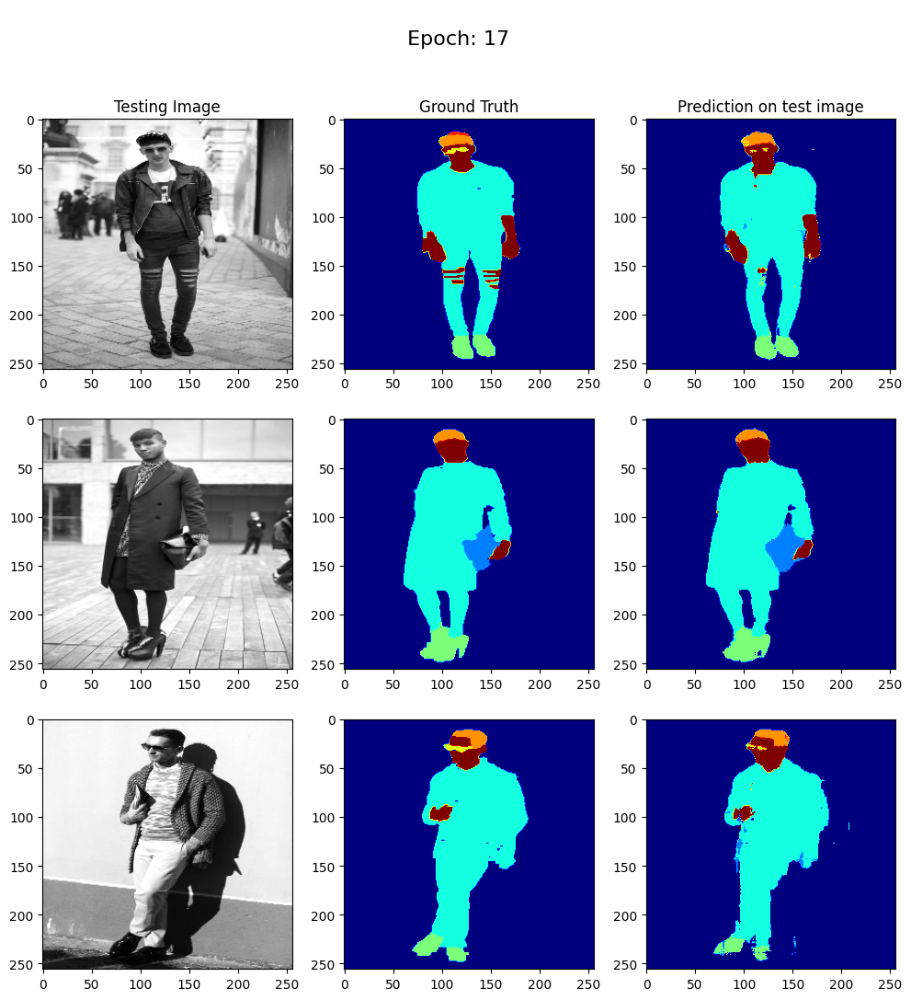


Sample Prediction after epoch 18

57/57 [==============================] - 9s 159ms/step - loss: 0.0550 - accuracy: 0.9806 - val_loss: 0.1535 - val_accuracy: 0.9516
Epoch 19/50
1/1 [==============================] - 0s 33ms/step


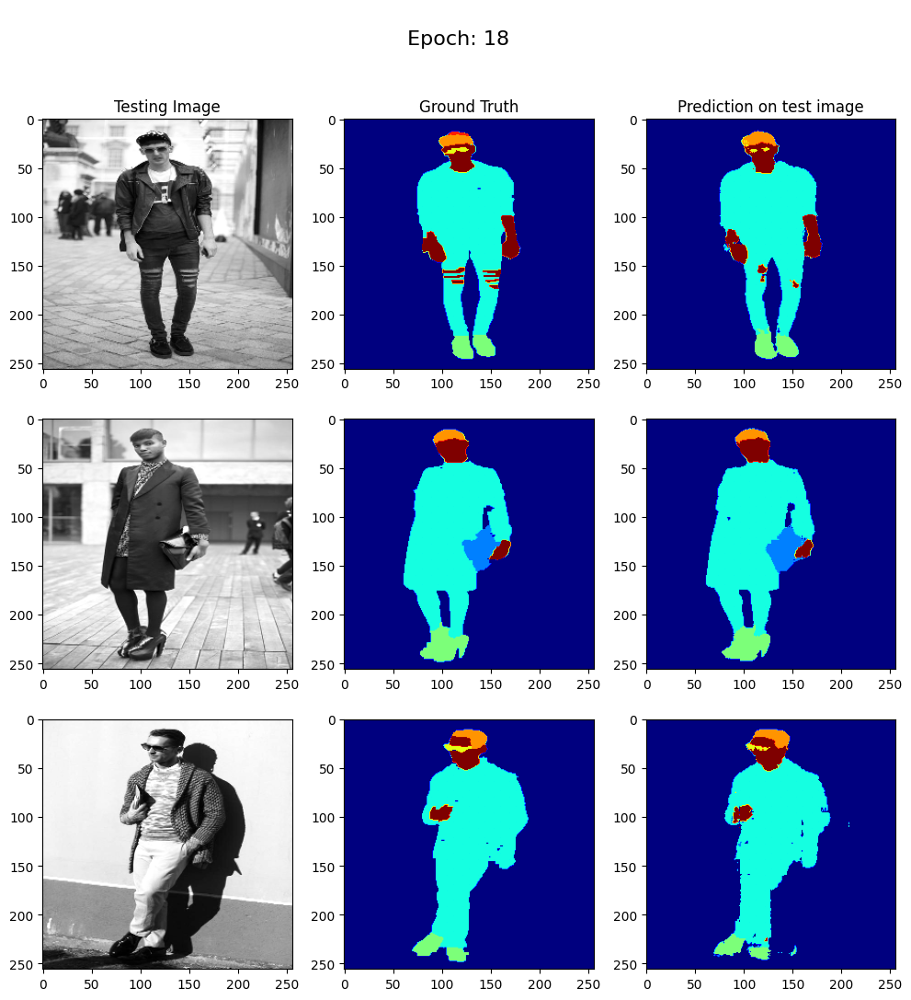


Sample Prediction after epoch 19

57/57 [==============================] - 9s 163ms/step - loss: 0.0514 - accuracy: 0.9818 - val_loss: 0.1514 - val_accuracy: 0.9539
Epoch 20/50
1/1 [==============================] - 0s 67ms/step


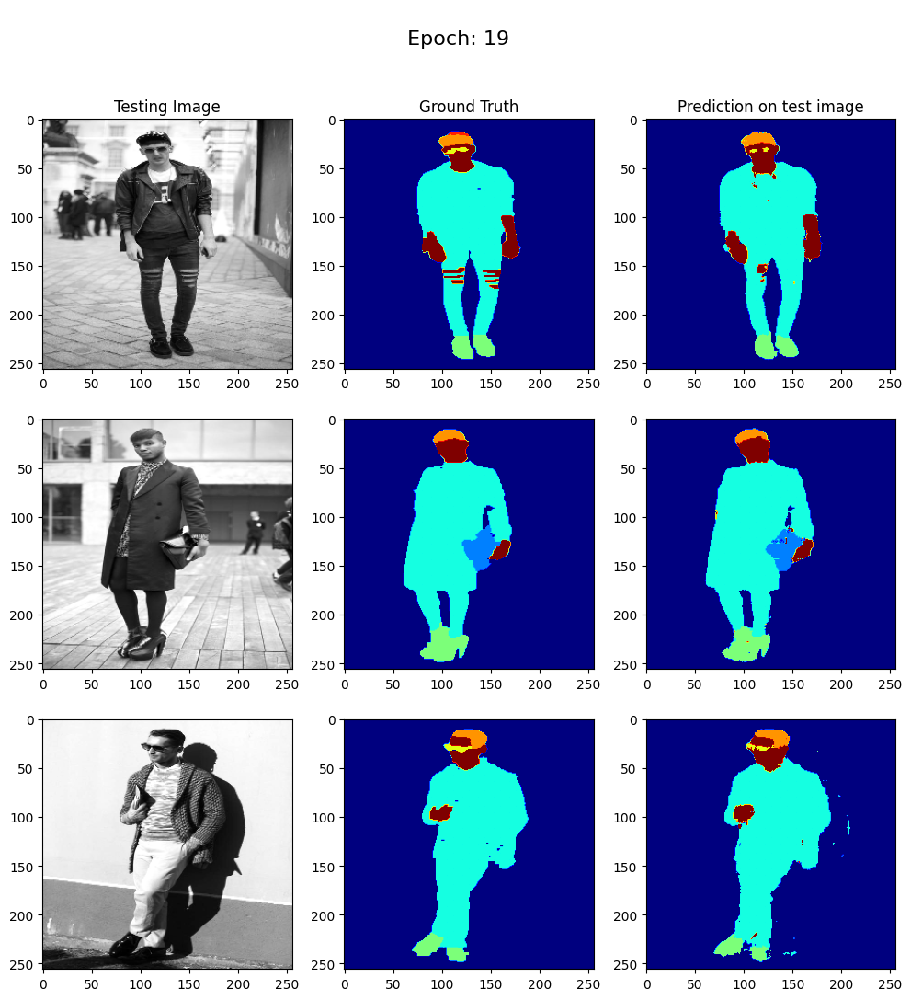


Sample Prediction after epoch 20

57/57 [==============================] - 10s 176ms/step - loss: 0.0477 - accuracy: 0.9830 - val_loss: 0.1512 - val_accuracy: 0.9552
Epoch 21/50
1/1 [==============================] - 0s 26ms/step


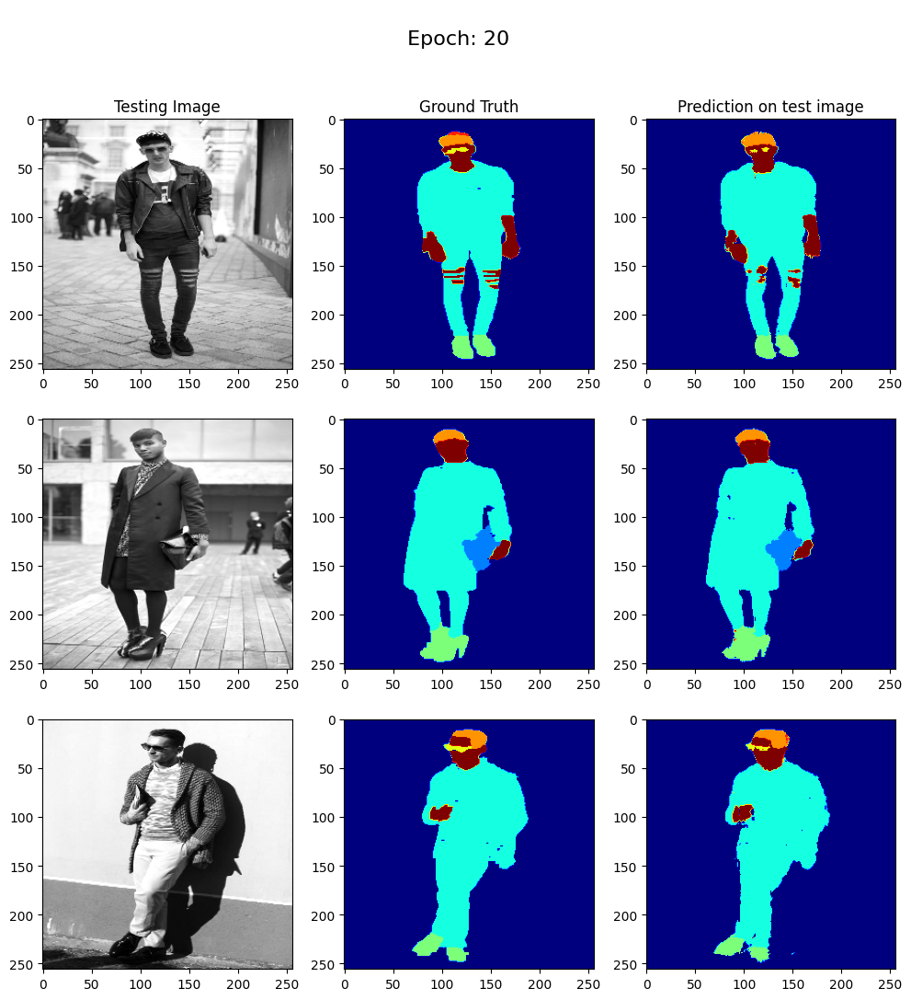


Sample Prediction after epoch 21

57/57 [==============================] - 9s 162ms/step - loss: 0.0437 - accuracy: 0.9843 - val_loss: 0.1593 - val_accuracy: 0.9544
Epoch 22/50
1/1 [==============================] - 0s 46ms/step


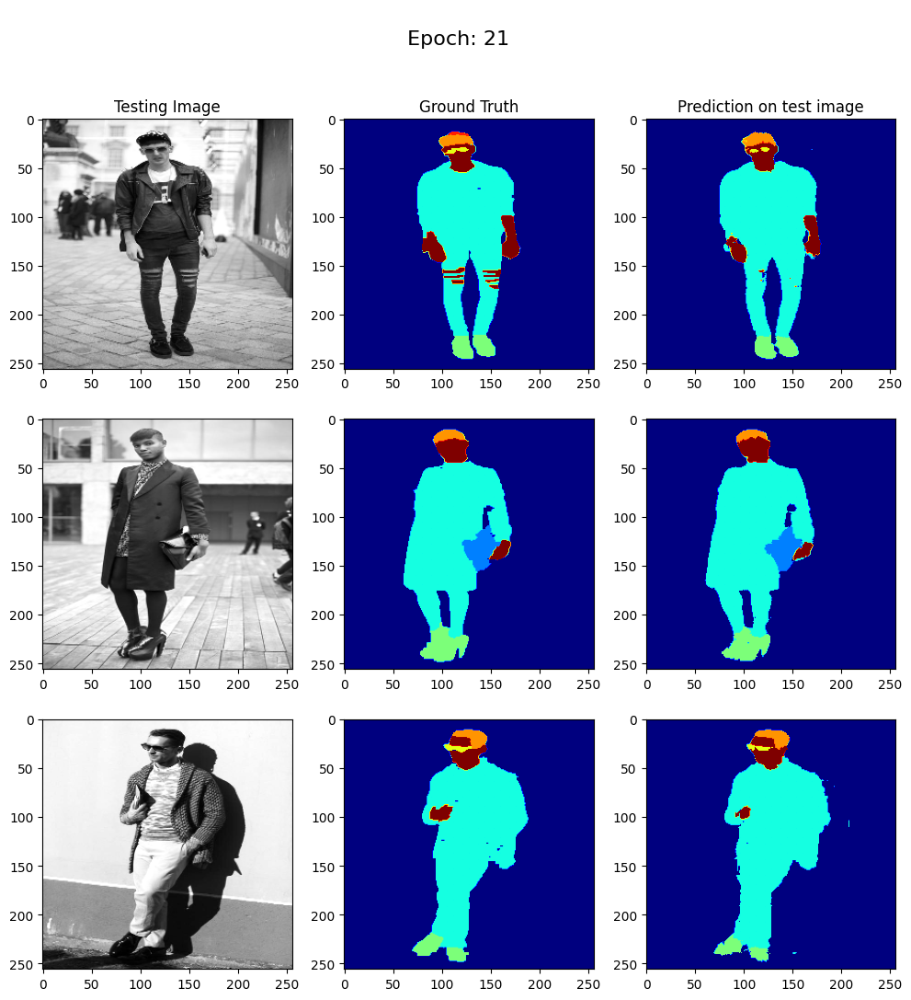


Sample Prediction after epoch 22

57/57 [==============================] - 9s 165ms/step - loss: 0.0401 - accuracy: 0.9855 - val_loss: 0.1702 - val_accuracy: 0.9546
Epoch 23/50
1/1 [==============================] - 0s 39ms/step


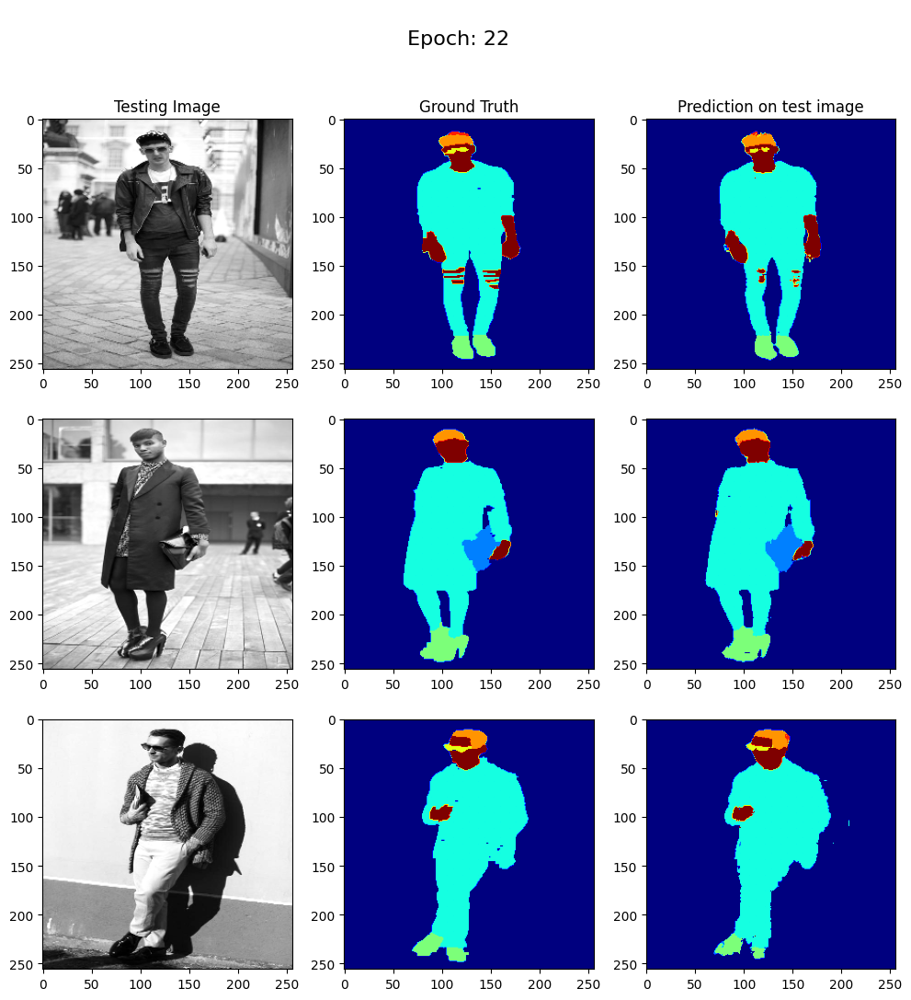


Sample Prediction after epoch 23

57/57 [==============================] - 10s 170ms/step - loss: 0.0381 - accuracy: 0.9862 - val_loss: 0.1662 - val_accuracy: 0.9552
Epoch 24/50
1/1 [==============================] - 0s 46ms/step


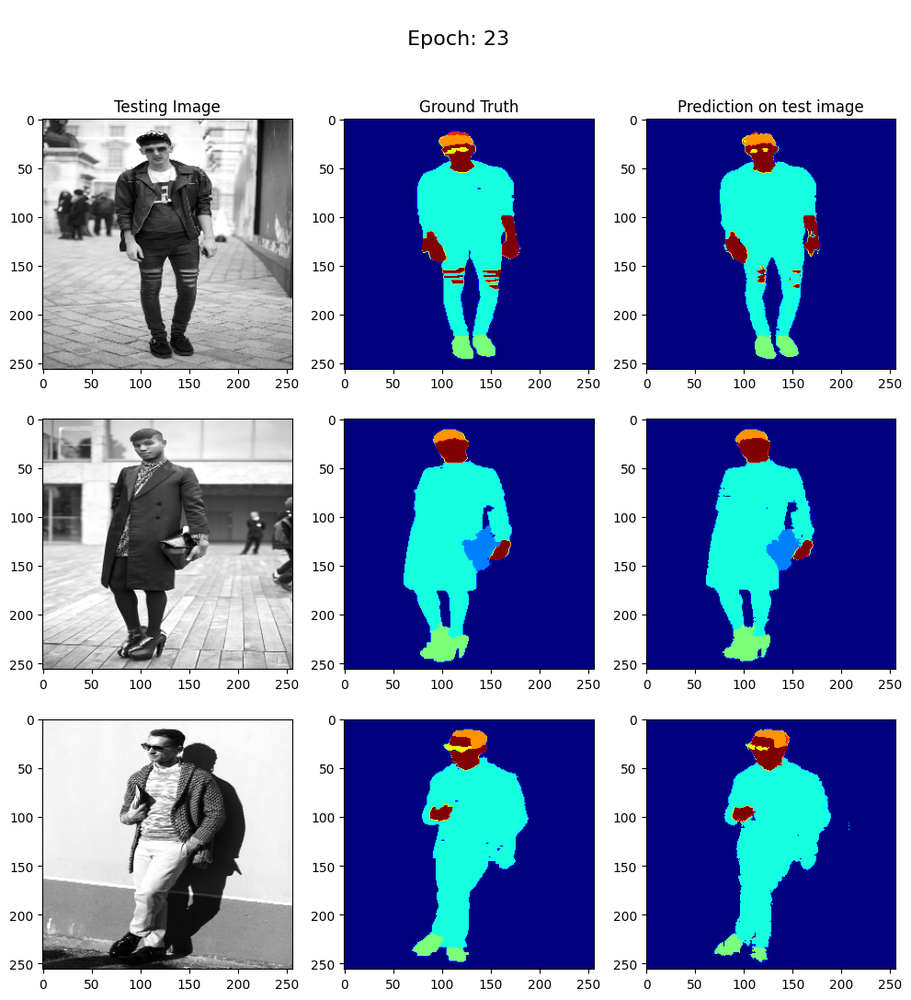


Sample Prediction after epoch 24

57/57 [==============================] - 9s 159ms/step - loss: 0.0353 - accuracy: 0.9872 - val_loss: 0.1765 - val_accuracy: 0.9554
Epoch 25/50
1/1 [==============================] - 0s 33ms/step


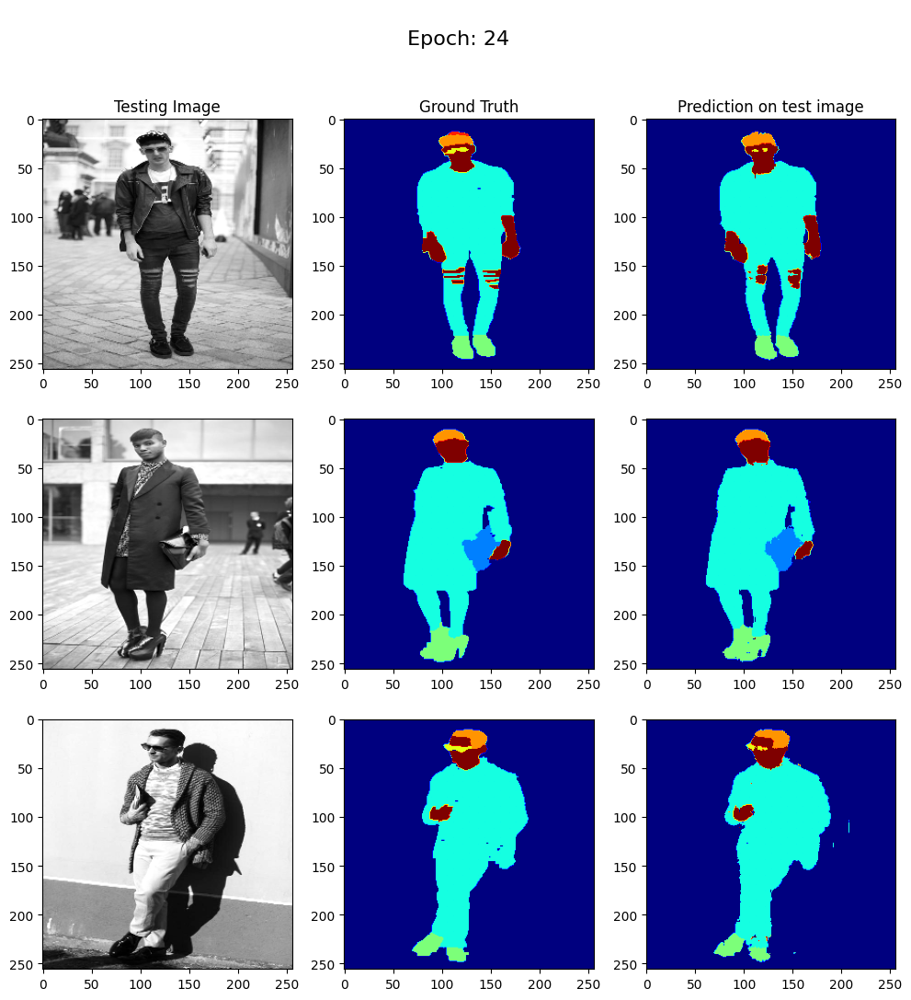


Sample Prediction after epoch 25

57/57 [==============================] - 9s 166ms/step - loss: 0.0341 - accuracy: 0.9875 - val_loss: 0.1760 - val_accuracy: 0.9554
Epoch 26/50
1/1 [==============================] - 0s 68ms/step


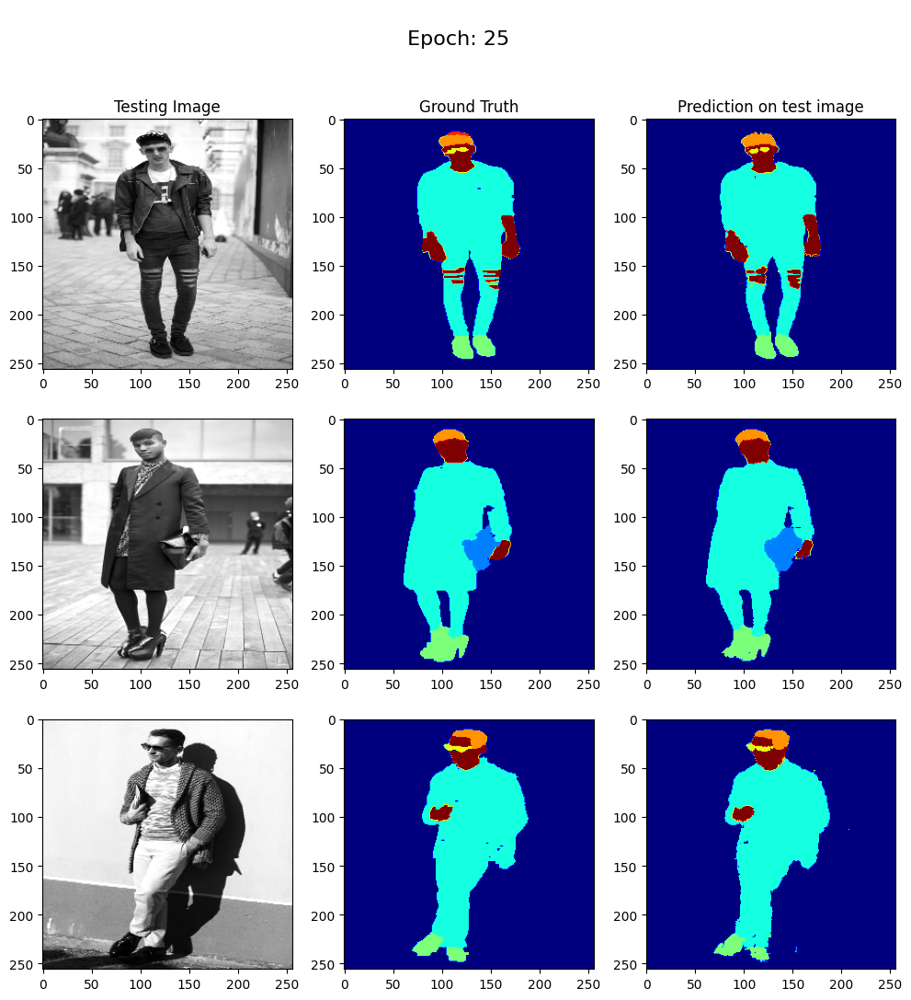


Sample Prediction after epoch 26

57/57 [==============================] - 11s 186ms/step - loss: 0.0330 - accuracy: 0.9878 - val_loss: 0.1793 - val_accuracy: 0.9541
Epoch 27/50
1/1 [==============================] - 0s 33ms/step


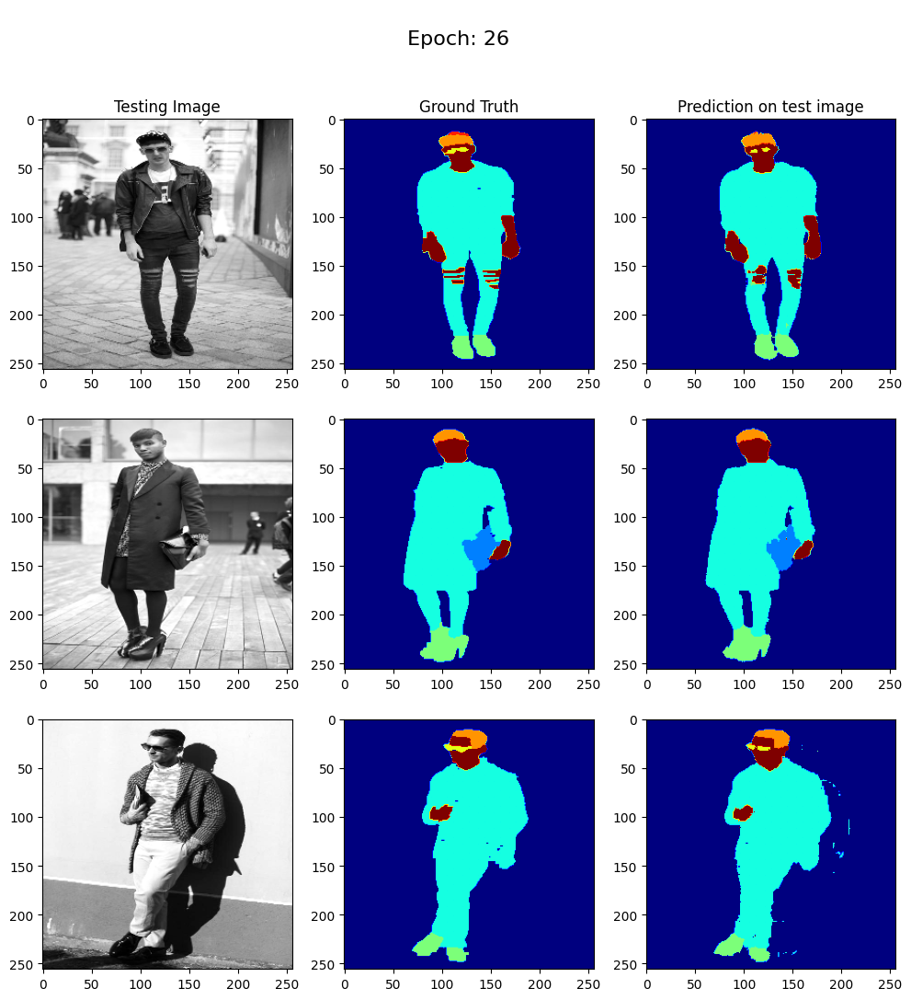


Sample Prediction after epoch 27

57/57 [==============================] - 9s 166ms/step - loss: 0.0307 - accuracy: 0.9886 - val_loss: 0.1763 - val_accuracy: 0.9569
Epoch 28/50
1/1 [==============================] - 0s 39ms/step


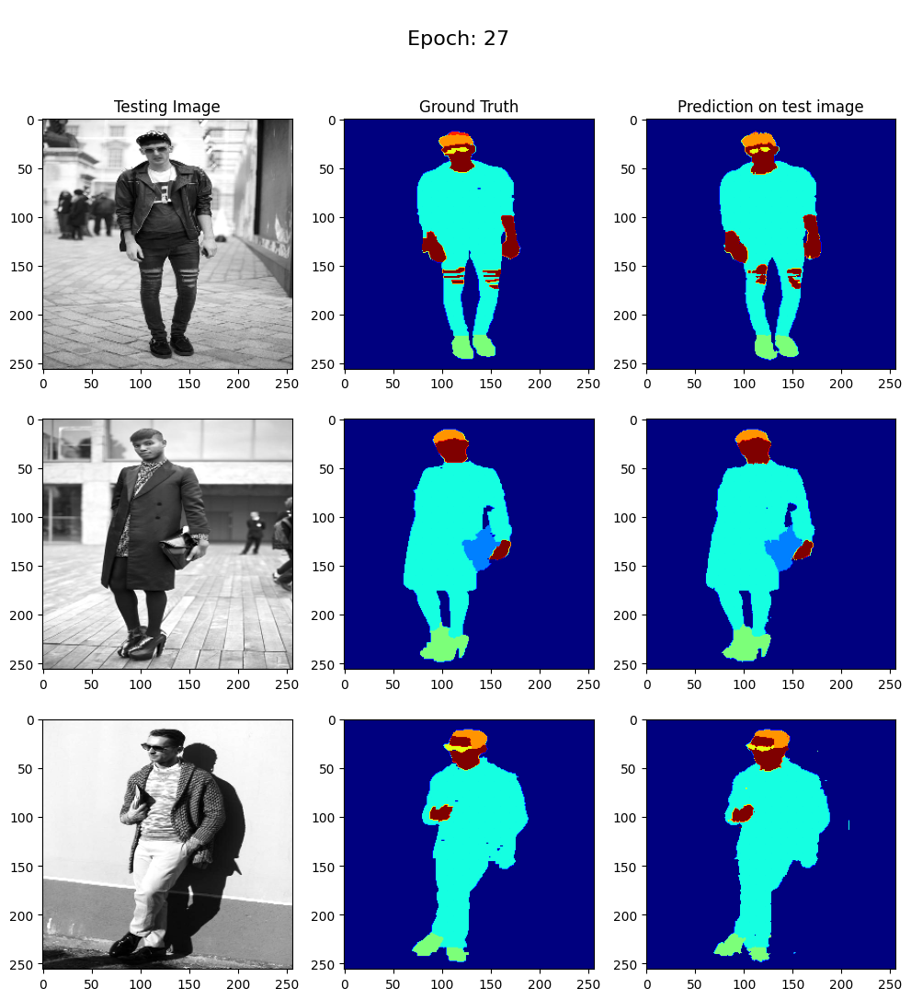


Sample Prediction after epoch 28

57/57 [==============================] - 10s 169ms/step - loss: 0.0285 - accuracy: 0.9894 - val_loss: 0.1792 - val_accuracy: 0.9550
Epoch 29/50
1/1 [==============================] - 0s 38ms/step


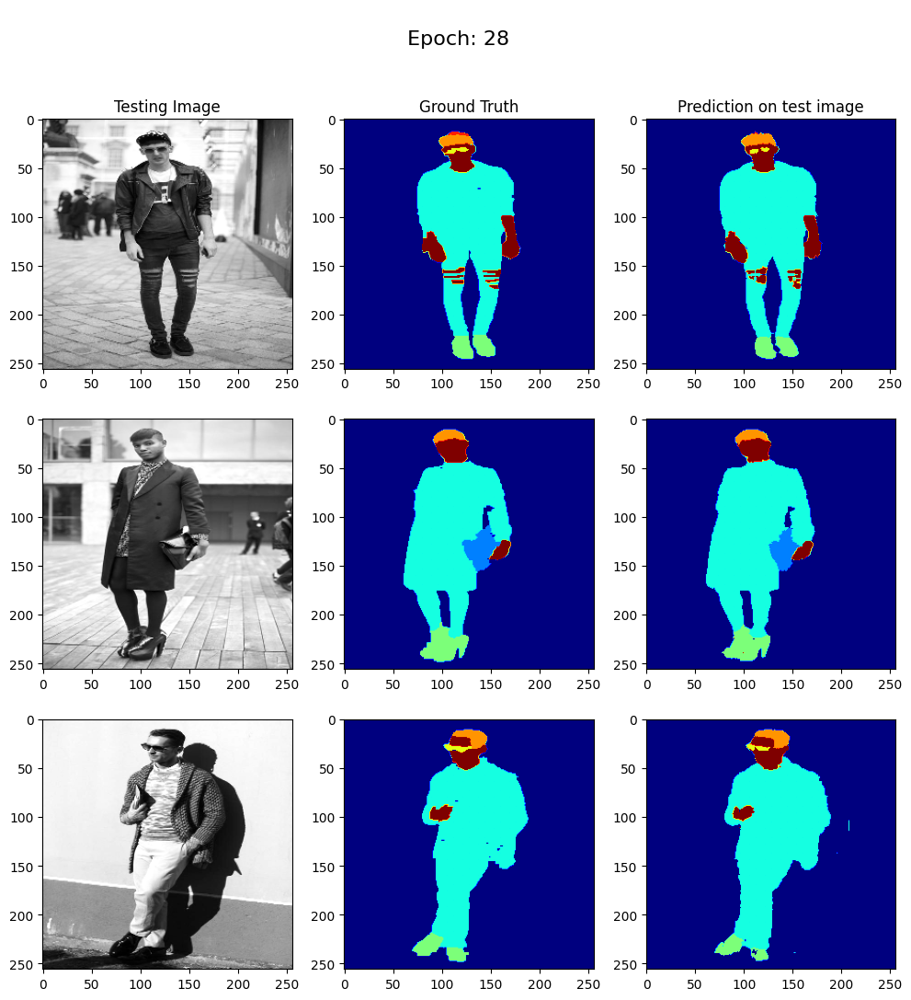


Sample Prediction after epoch 29

57/57 [==============================] - 10s 172ms/step - loss: 0.0269 - accuracy: 0.9899 - val_loss: 0.1869 - val_accuracy: 0.9563
Epoch 30/50
1/1 [==============================] - 0s 32ms/step


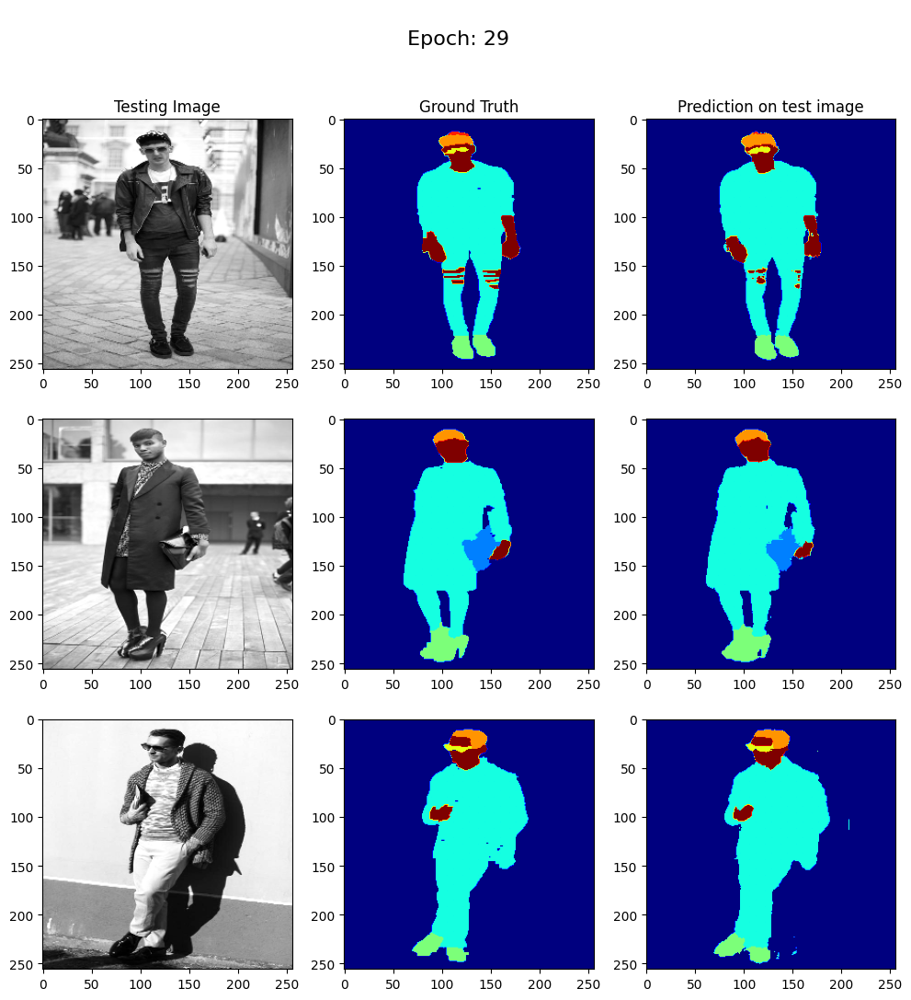


Sample Prediction after epoch 30

57/57 [==============================] - 9s 166ms/step - loss: 0.0258 - accuracy: 0.9903 - val_loss: 0.1926 - val_accuracy: 0.9562
Epoch 31/50
1/1 [==============================] - 0s 49ms/step


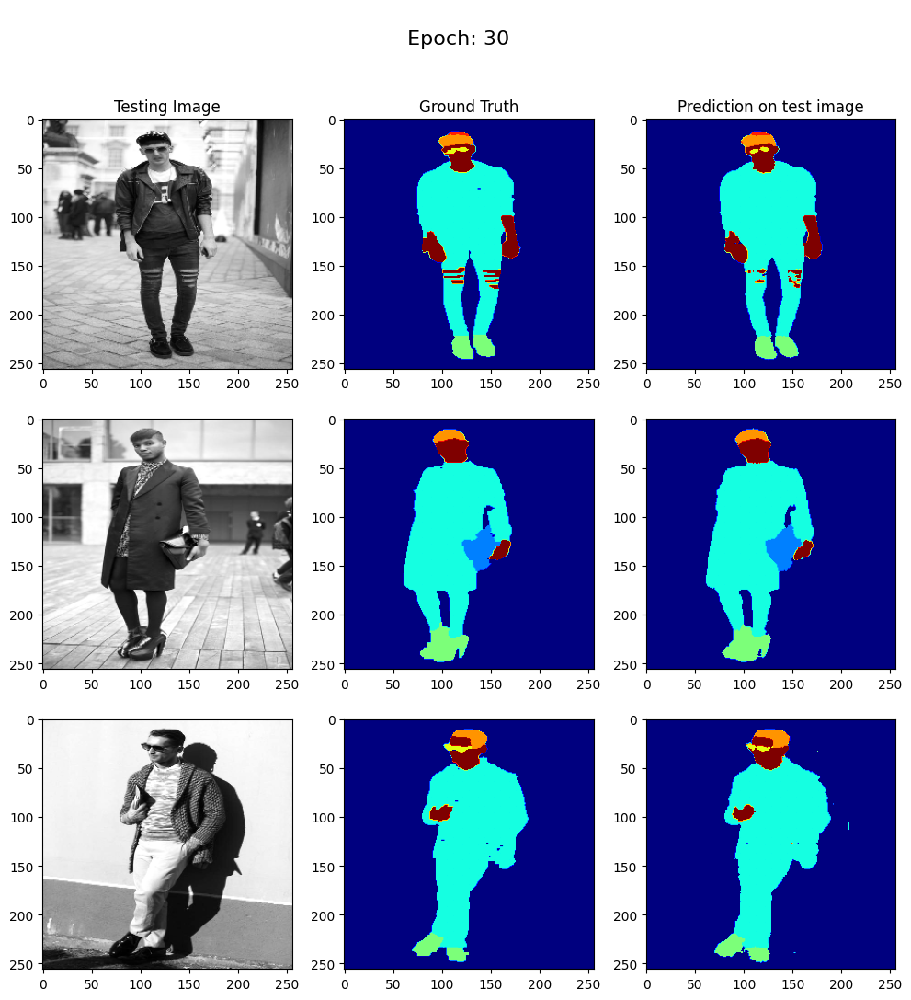


Sample Prediction after epoch 31

57/57 [==============================] - 11s 185ms/step - loss: 0.0249 - accuracy: 0.9906 - val_loss: 0.1890 - val_accuracy: 0.9563
Epoch 32/50
1/1 [==============================] - 0s 31ms/step


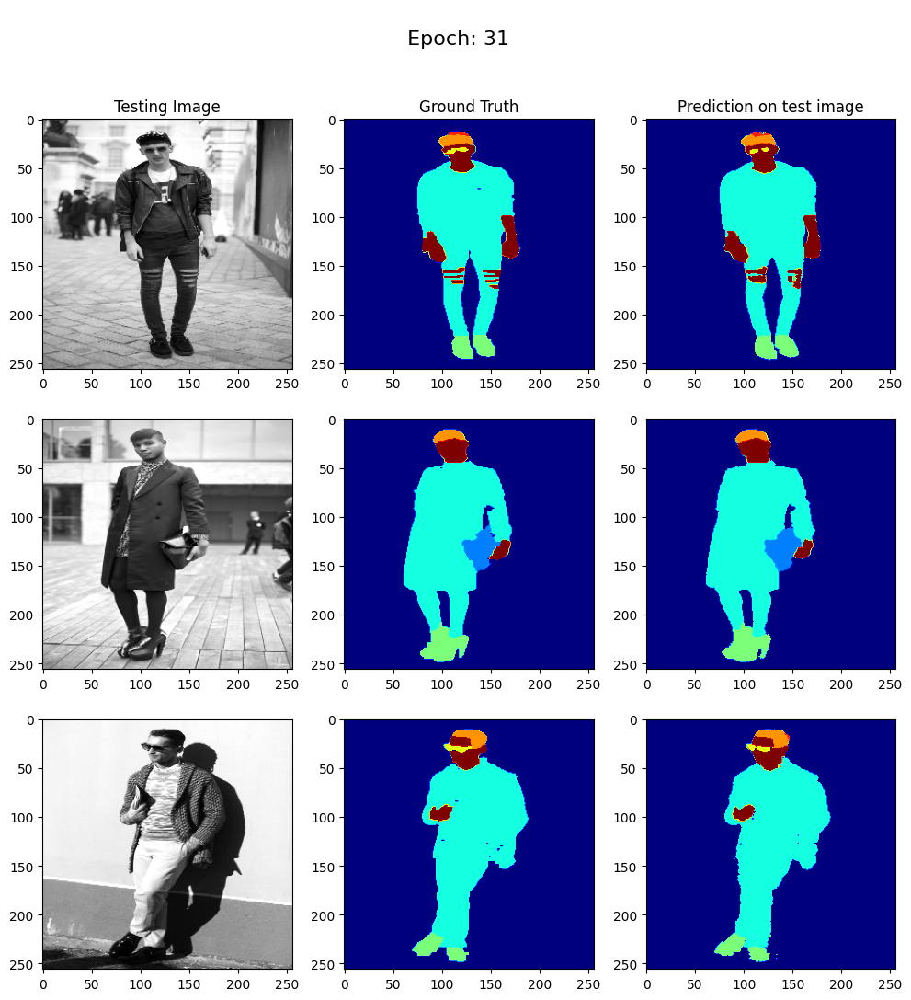


Sample Prediction after epoch 32

57/57 [==============================] - 10s 170ms/step - loss: 0.0233 - accuracy: 0.9912 - val_loss: 0.1905 - val_accuracy: 0.9554
Epoch 33/50
1/1 [==============================] - 0s 33ms/step


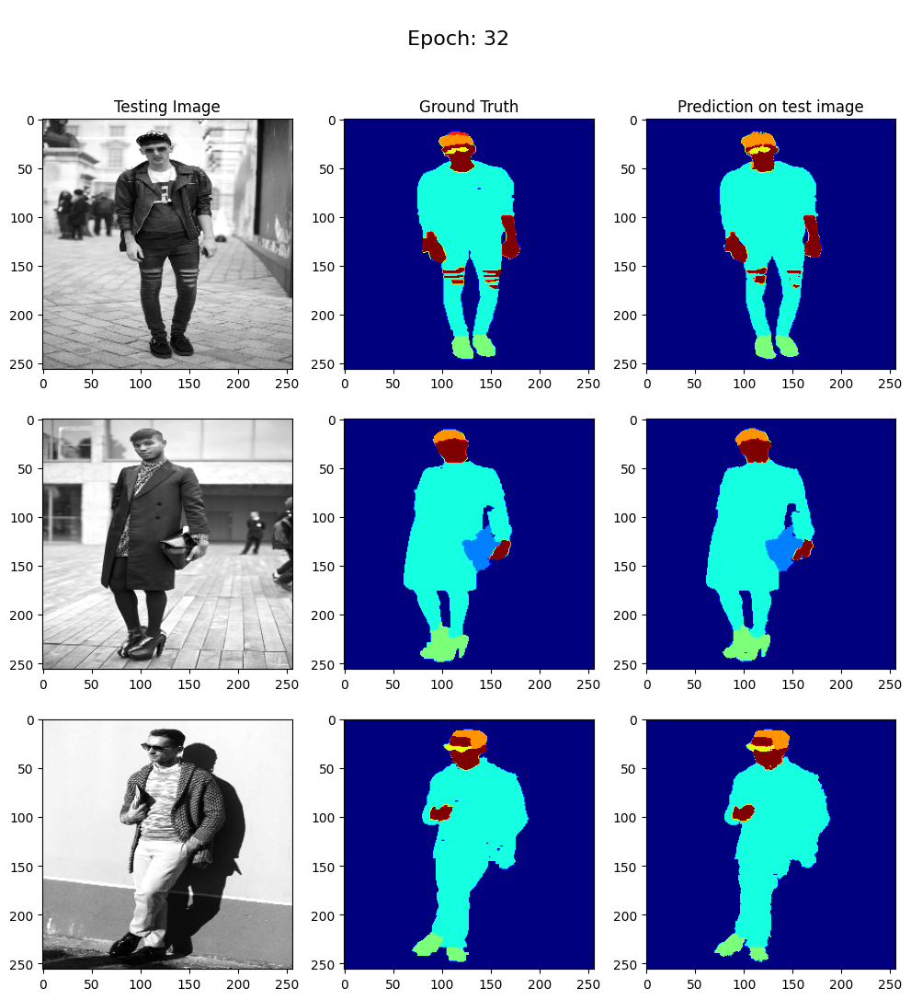


Sample Prediction after epoch 33

57/57 [==============================] - 9s 165ms/step - loss: 0.0231 - accuracy: 0.9913 - val_loss: 0.2002 - val_accuracy: 0.9546
Epoch 34/50
1/1 [==============================] - 0s 52ms/step


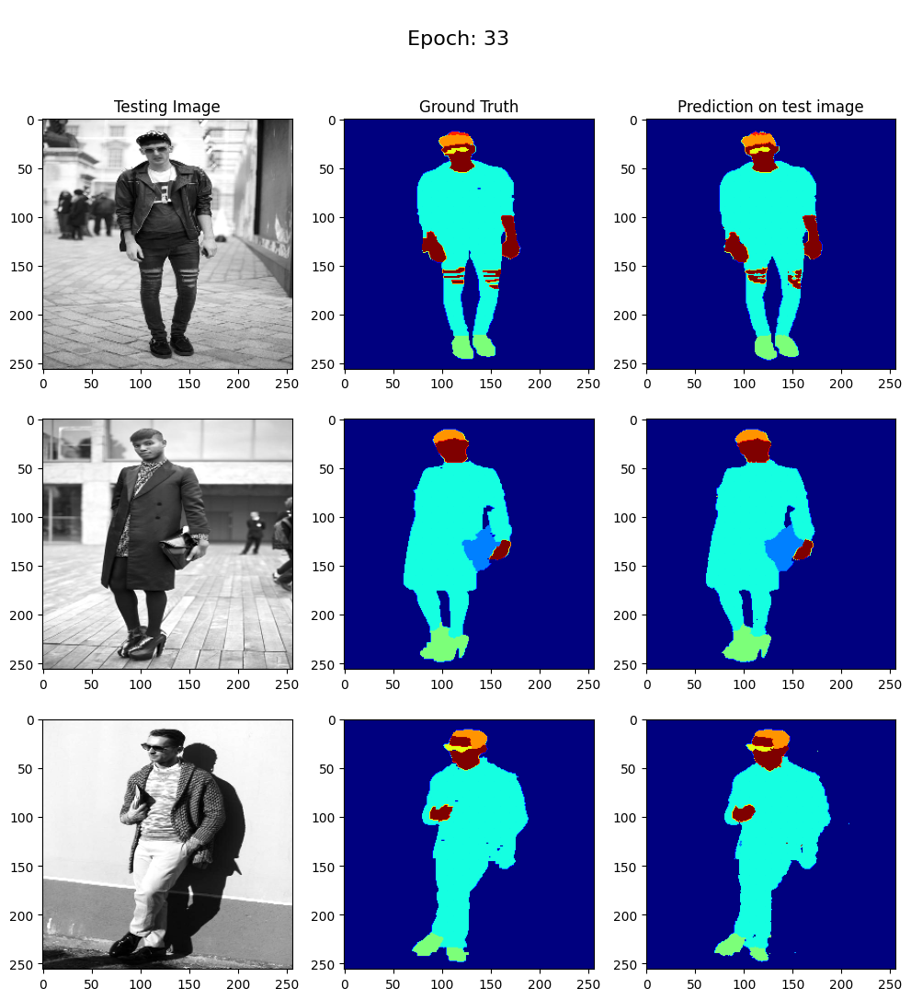


Sample Prediction after epoch 34

57/57 [==============================] - 10s 177ms/step - loss: 0.0221 - accuracy: 0.9916 - val_loss: 0.1908 - val_accuracy: 0.9559
Epoch 35/50
1/1 [==============================] - 0s 31ms/step


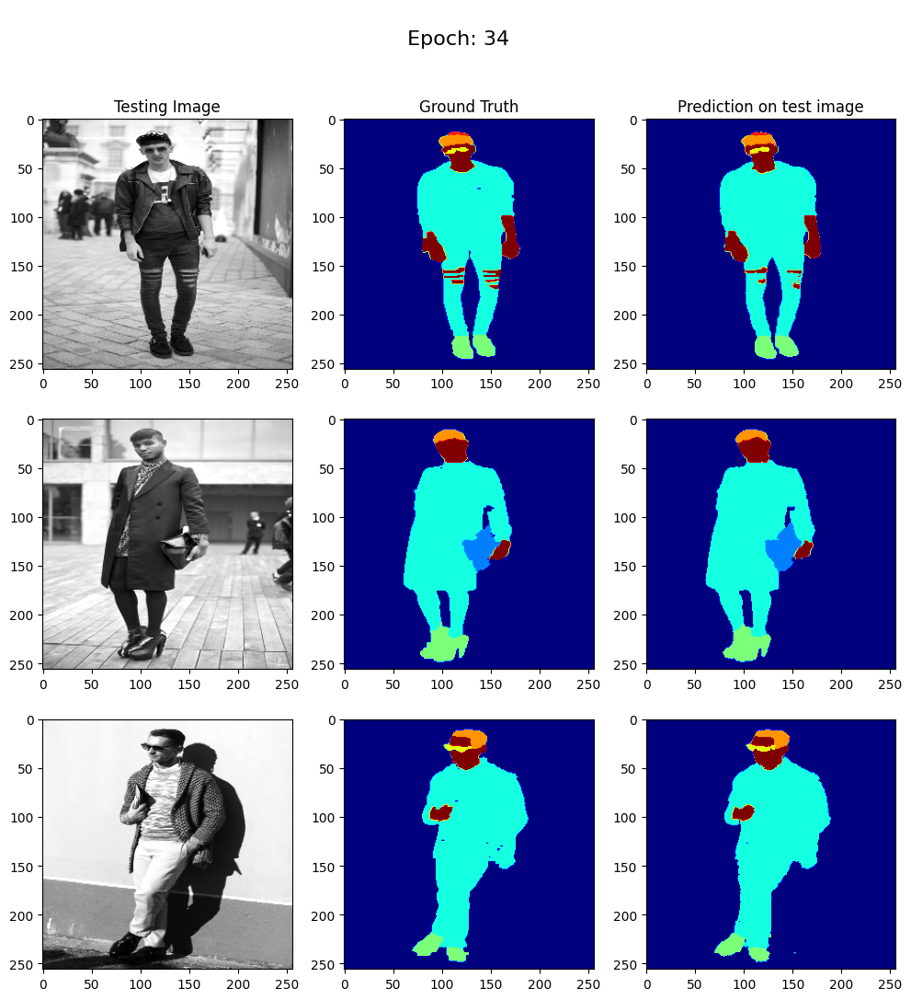


Sample Prediction after epoch 35

57/57 [==============================] - 10s 168ms/step - loss: 0.0216 - accuracy: 0.9918 - val_loss: 0.1955 - val_accuracy: 0.9563
Epoch 36/50
1/1 [==============================] - 0s 32ms/step


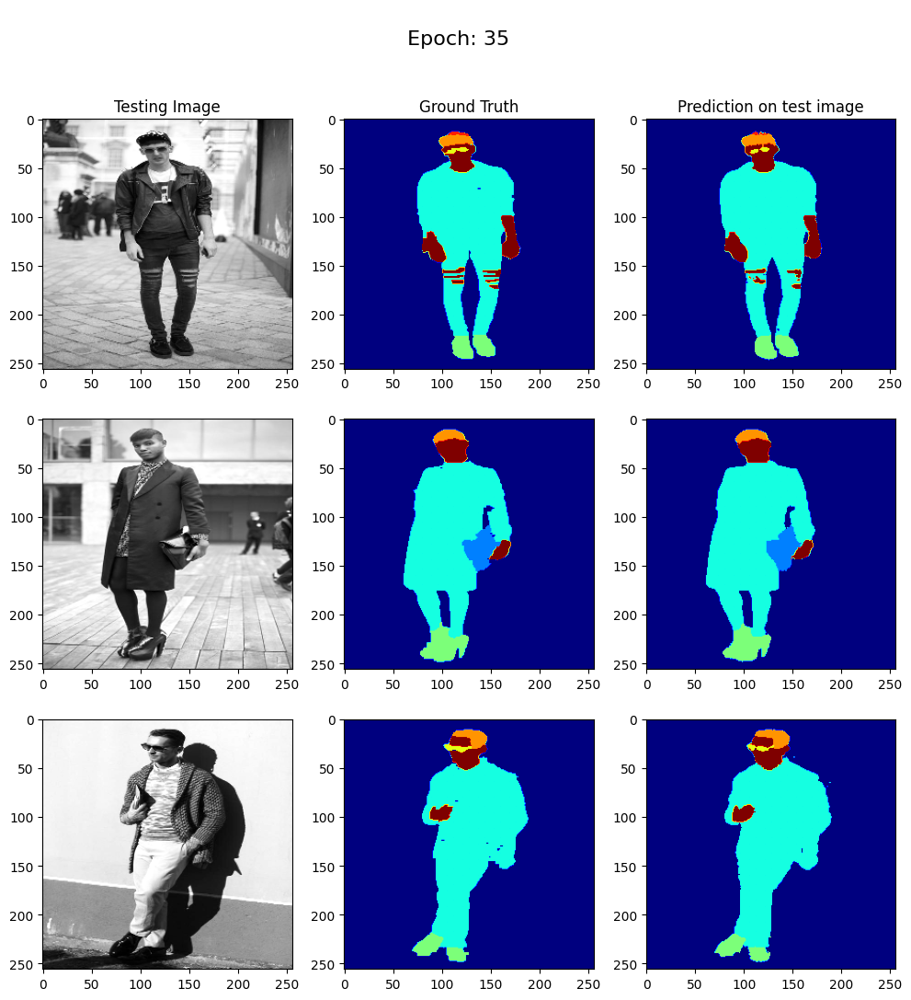


Sample Prediction after epoch 36

57/57 [==============================] - 10s 174ms/step - loss: 0.0207 - accuracy: 0.9921 - val_loss: 0.2038 - val_accuracy: 0.9566
Epoch 37/50
1/1 [==============================] - 0s 45ms/step


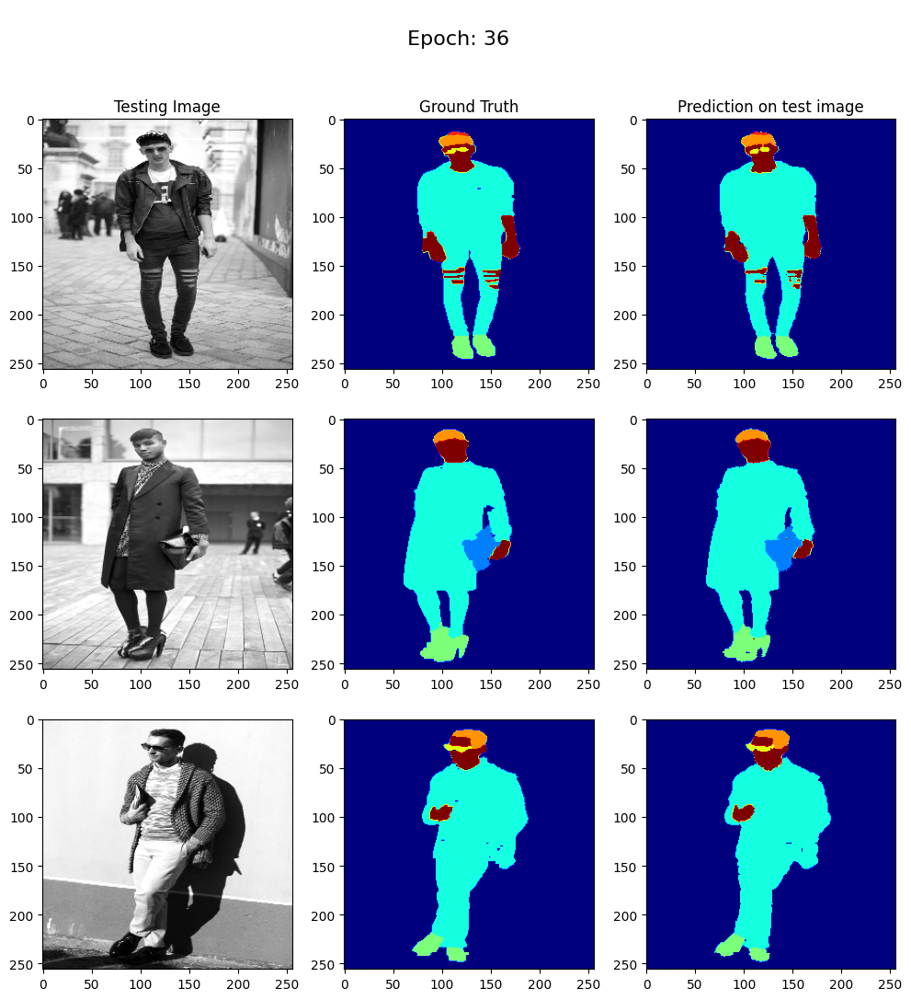


Sample Prediction after epoch 37

57/57 [==============================] - 10s 174ms/step - loss: 0.0201 - accuracy: 0.9923 - val_loss: 0.2053 - val_accuracy: 0.9550
Epoch 38/50
1/1 [==============================] - 0s 32ms/step


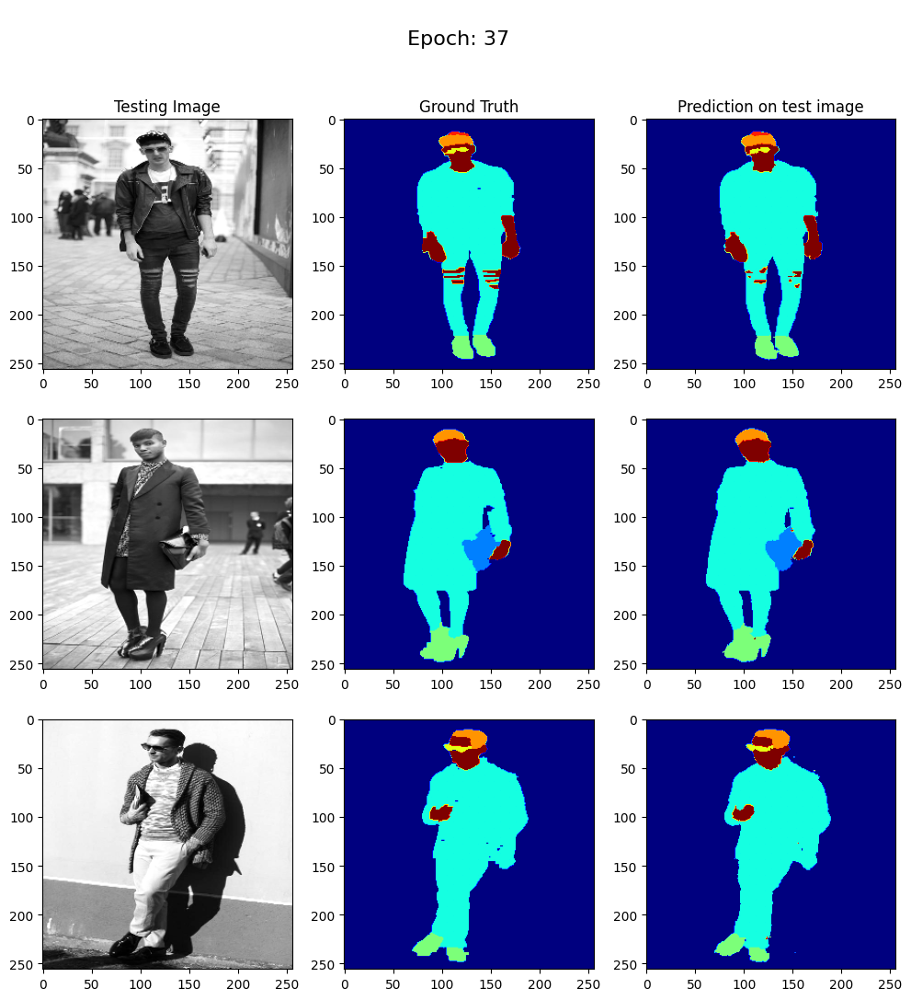


Sample Prediction after epoch 38

57/57 [==============================] - 10s 169ms/step - loss: 0.0209 - accuracy: 0.9920 - val_loss: 0.2056 - val_accuracy: 0.9563
Epoch 39/50
1/1 [==============================] - 0s 33ms/step


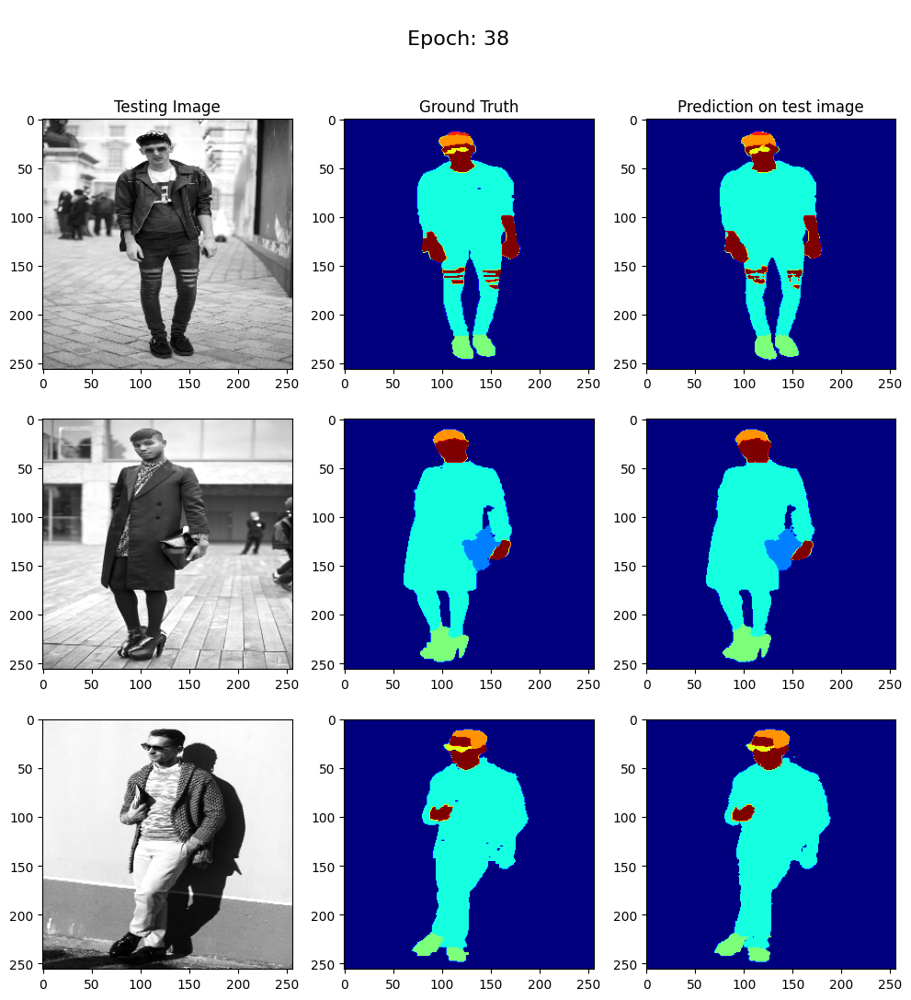


Sample Prediction after epoch 39

57/57 [==============================] - 10s 167ms/step - loss: 0.0200 - accuracy: 0.9923 - val_loss: 0.2029 - val_accuracy: 0.9562
Epoch 40/50
1/1 [==============================] - 0s 31ms/step


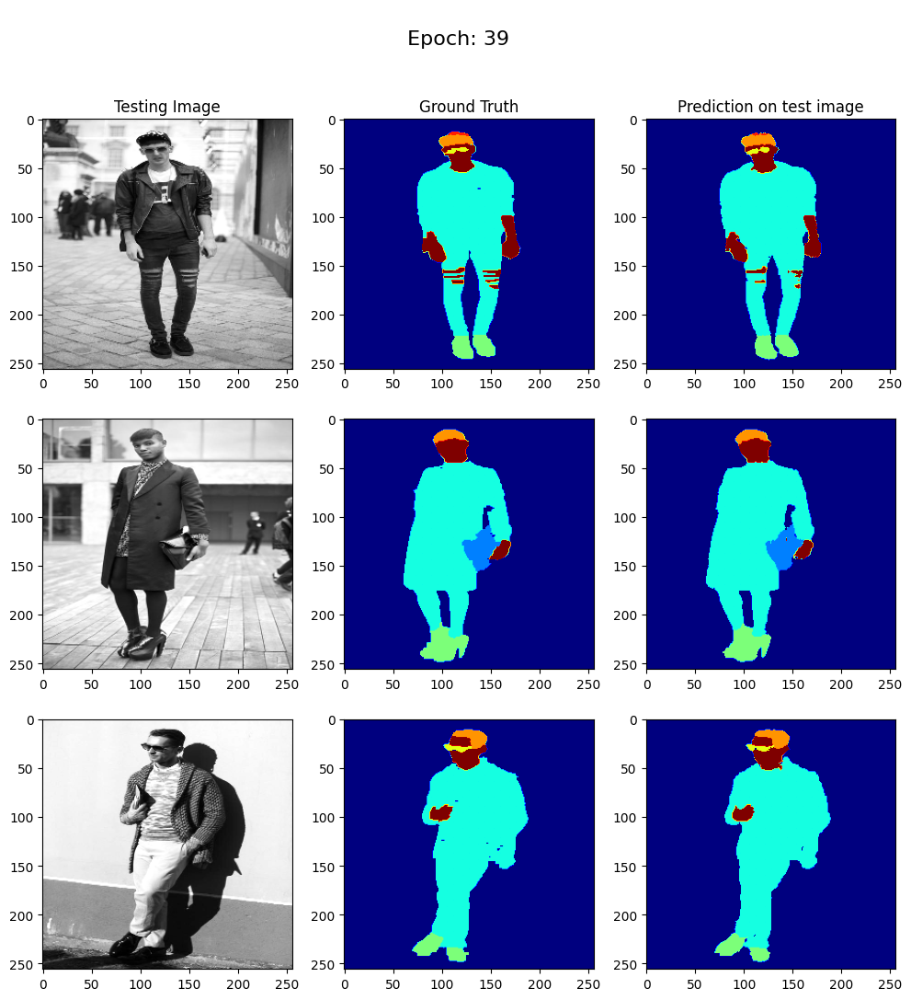


Sample Prediction after epoch 40

57/57 [==============================] - 10s 172ms/step - loss: 0.0182 - accuracy: 0.9930 - val_loss: 0.2093 - val_accuracy: 0.9556
Epoch 41/50
1/1 [==============================] - 0s 31ms/step


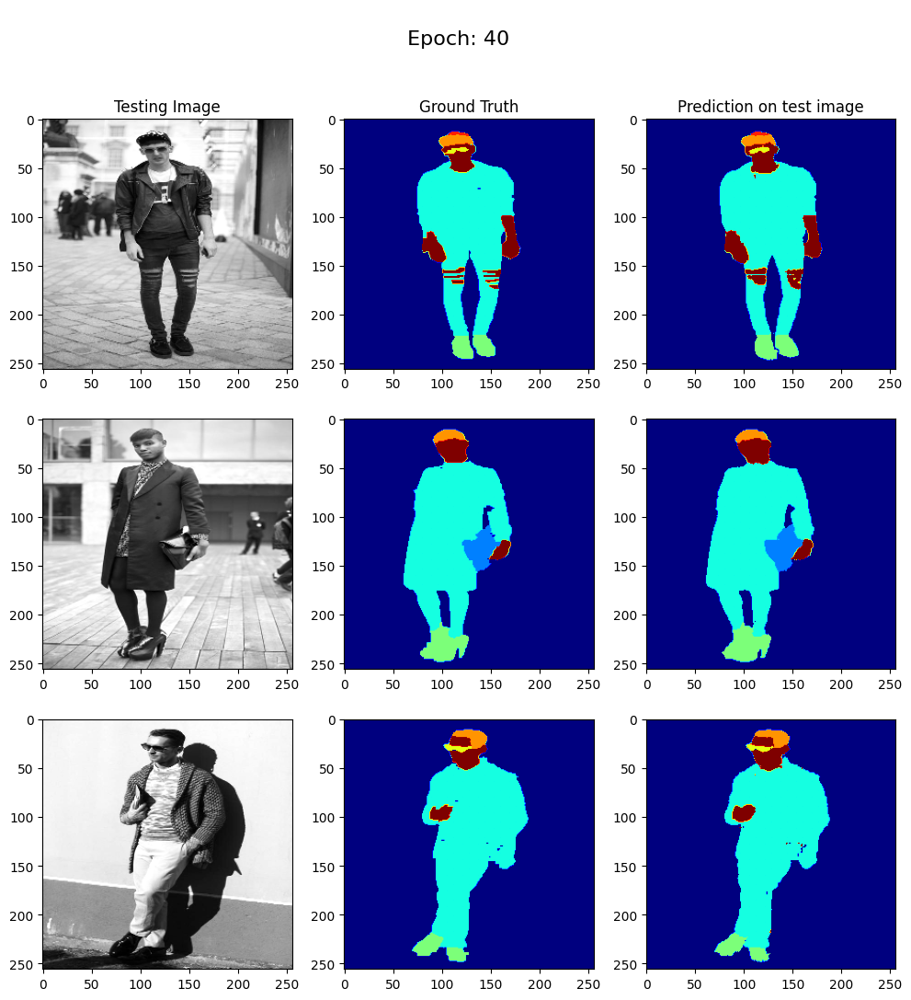


Sample Prediction after epoch 41

57/57 [==============================] - 10s 176ms/step - loss: 0.0176 - accuracy: 0.9932 - val_loss: 0.2109 - val_accuracy: 0.9548
Epoch 42/50
1/1 [==============================] - 0s 45ms/step


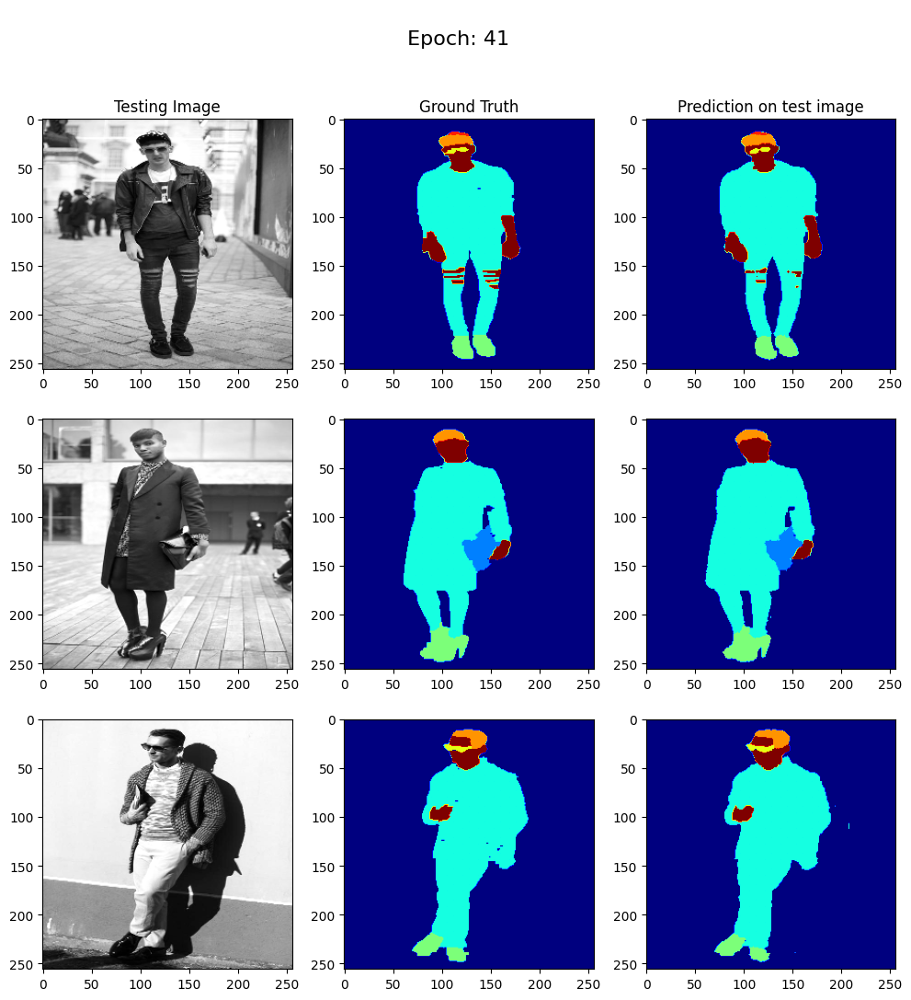


Sample Prediction after epoch 42

57/57 [==============================] - 10s 174ms/step - loss: 0.0172 - accuracy: 0.9934 - val_loss: 0.2189 - val_accuracy: 0.9562
Epoch 43/50
1/1 [==============================] - 0s 51ms/step


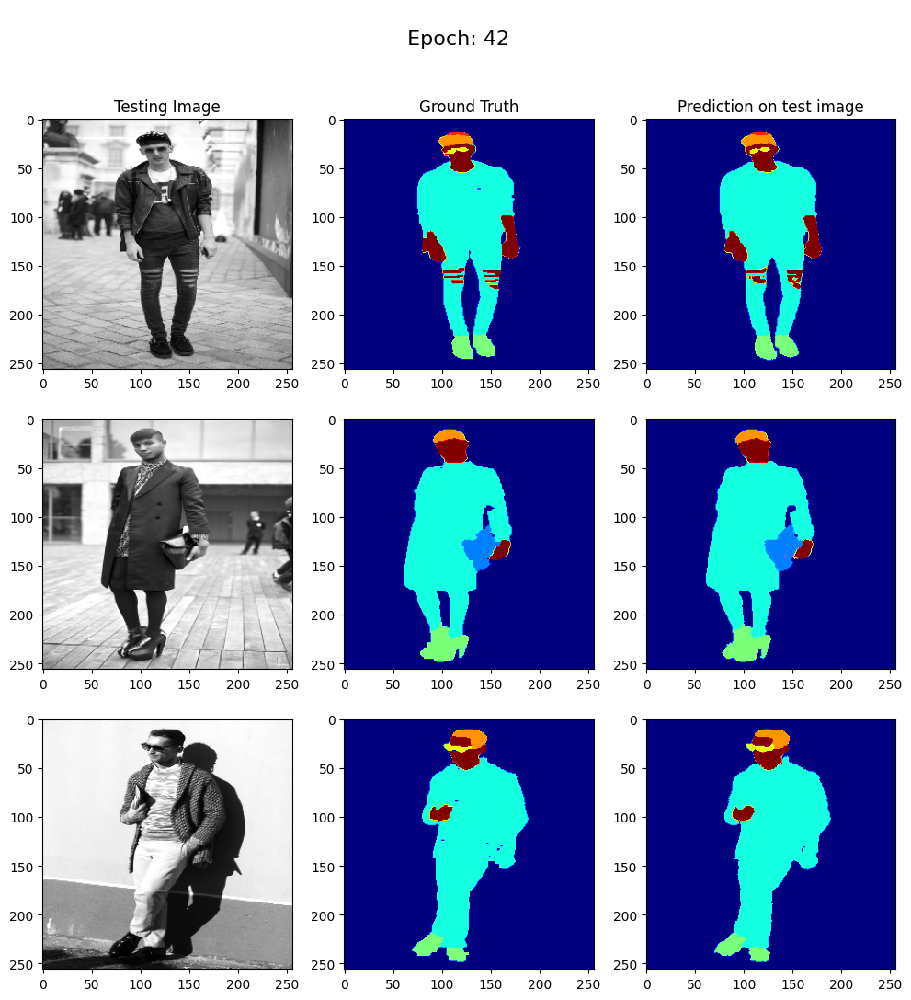


Sample Prediction after epoch 43

57/57 [==============================] - 10s 172ms/step - loss: 0.0168 - accuracy: 0.9935 - val_loss: 0.2125 - val_accuracy: 0.9563
Epoch 44/50
1/1 [==============================] - 0s 34ms/step


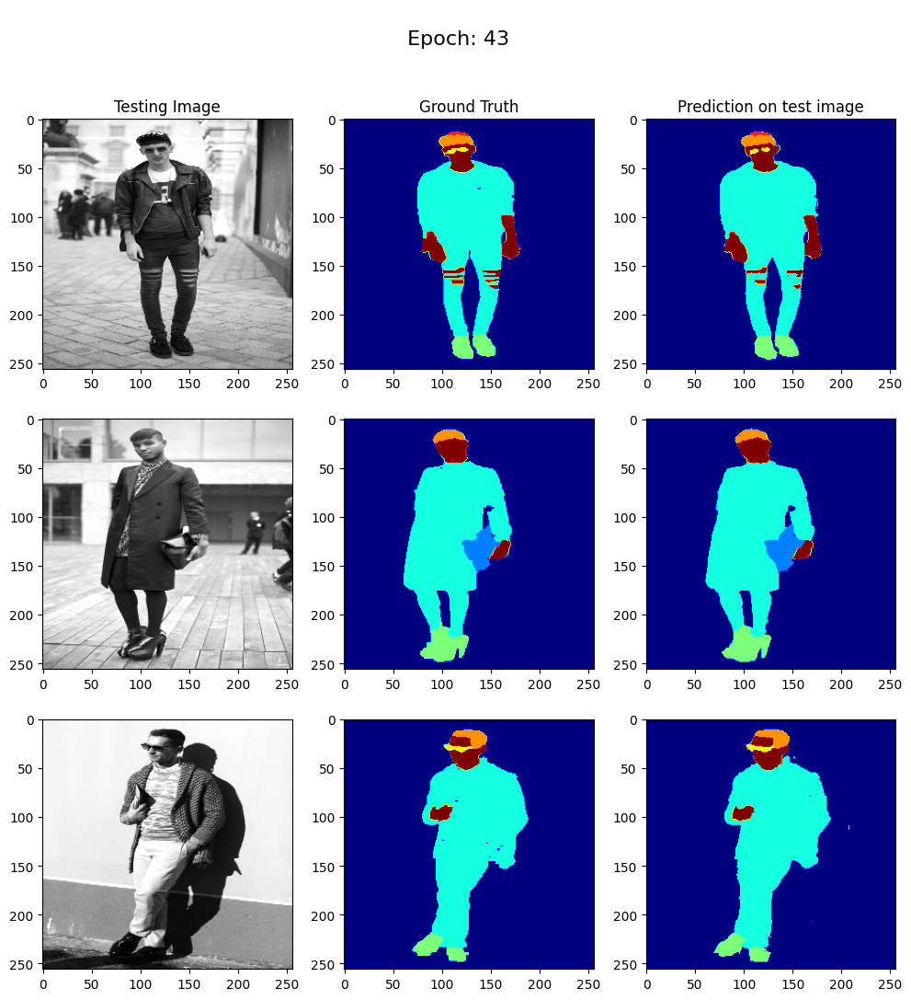


Sample Prediction after epoch 44

57/57 [==============================] - 9s 166ms/step - loss: 0.0162 - accuracy: 0.9937 - val_loss: 0.2159 - val_accuracy: 0.9560
Epoch 45/50
1/1 [==============================] - 0s 41ms/step


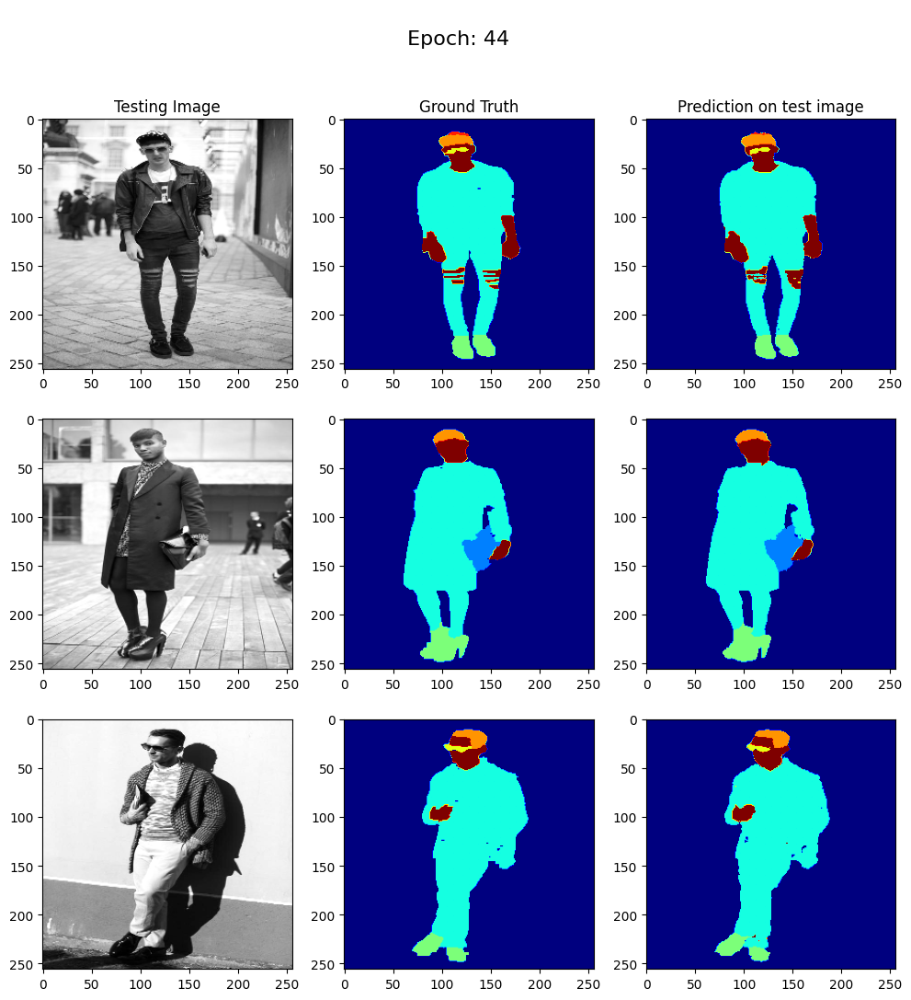


Sample Prediction after epoch 45

57/57 [==============================] - 10s 171ms/step - loss: 0.0159 - accuracy: 0.9939 - val_loss: 0.2194 - val_accuracy: 0.9550
Epoch 46/50
1/1 [==============================] - 0s 31ms/step


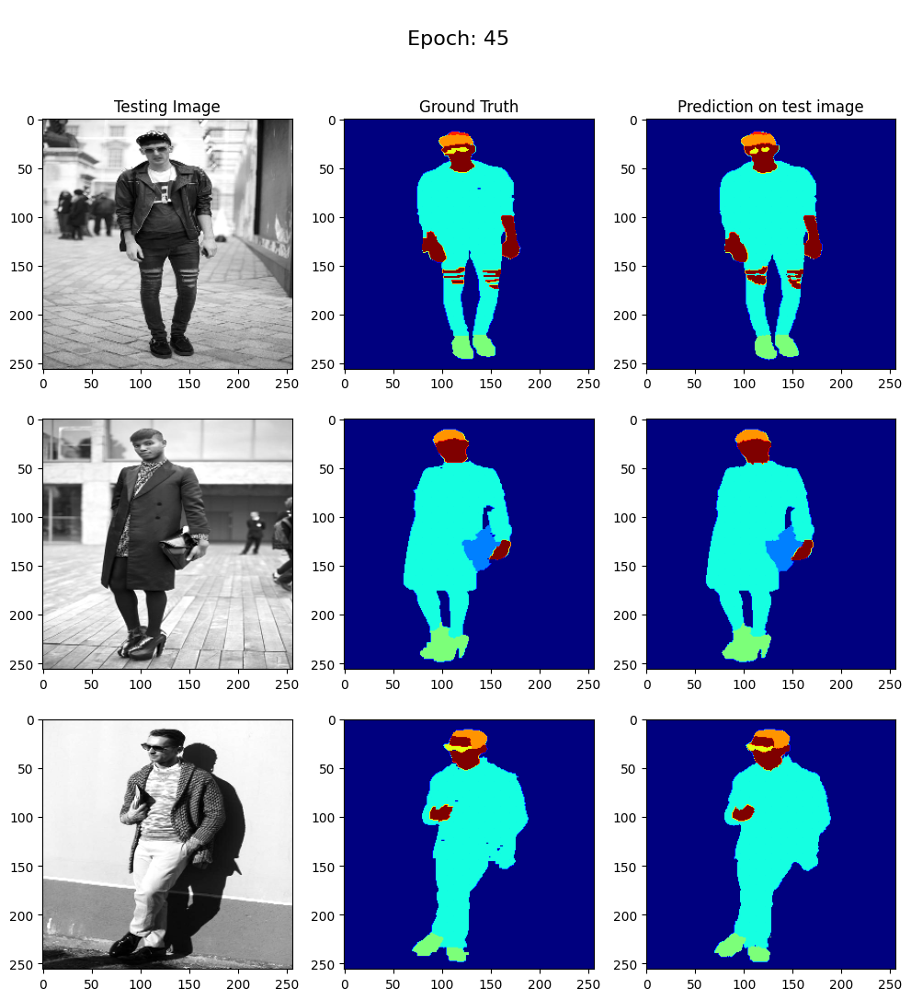


Sample Prediction after epoch 46

57/57 [==============================] - 10s 177ms/step - loss: 0.0157 - accuracy: 0.9939 - val_loss: 0.2153 - val_accuracy: 0.9563
Epoch 47/50
1/1 [==============================] - 0s 31ms/step


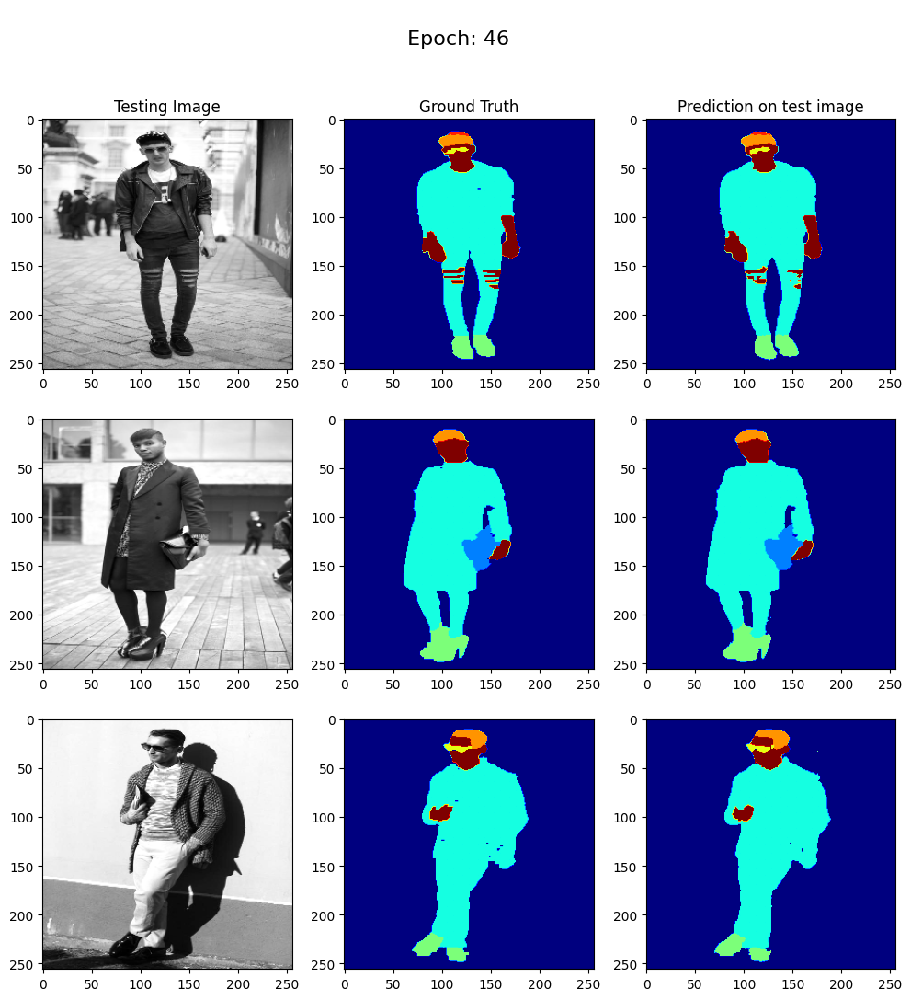


Sample Prediction after epoch 47

57/57 [==============================] - 9s 165ms/step - loss: 0.0158 - accuracy: 0.9939 - val_loss: 0.2227 - val_accuracy: 0.9564
Epoch 48/50
1/1 [==============================] - 0s 36ms/step


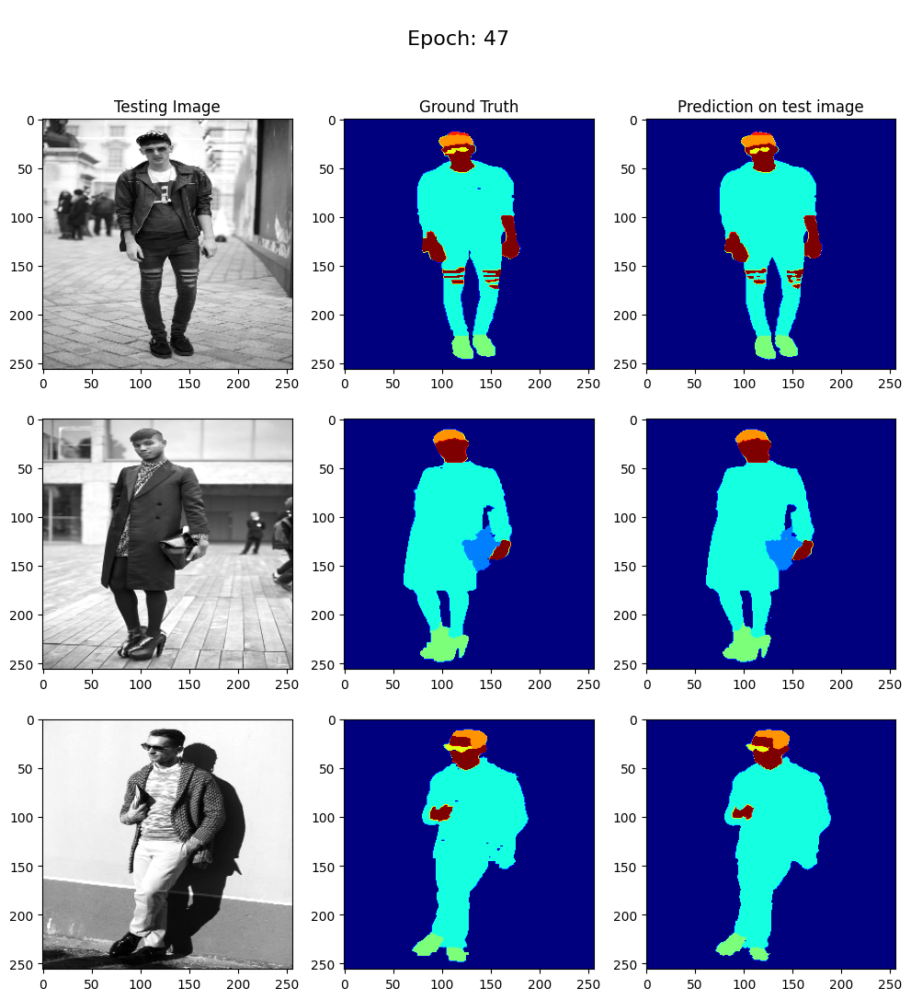


Sample Prediction after epoch 48

57/57 [==============================] - 10s 176ms/step - loss: 0.0150 - accuracy: 0.9942 - val_loss: 0.2245 - val_accuracy: 0.9565
Epoch 49/50
1/1 [==============================] - 0s 34ms/step


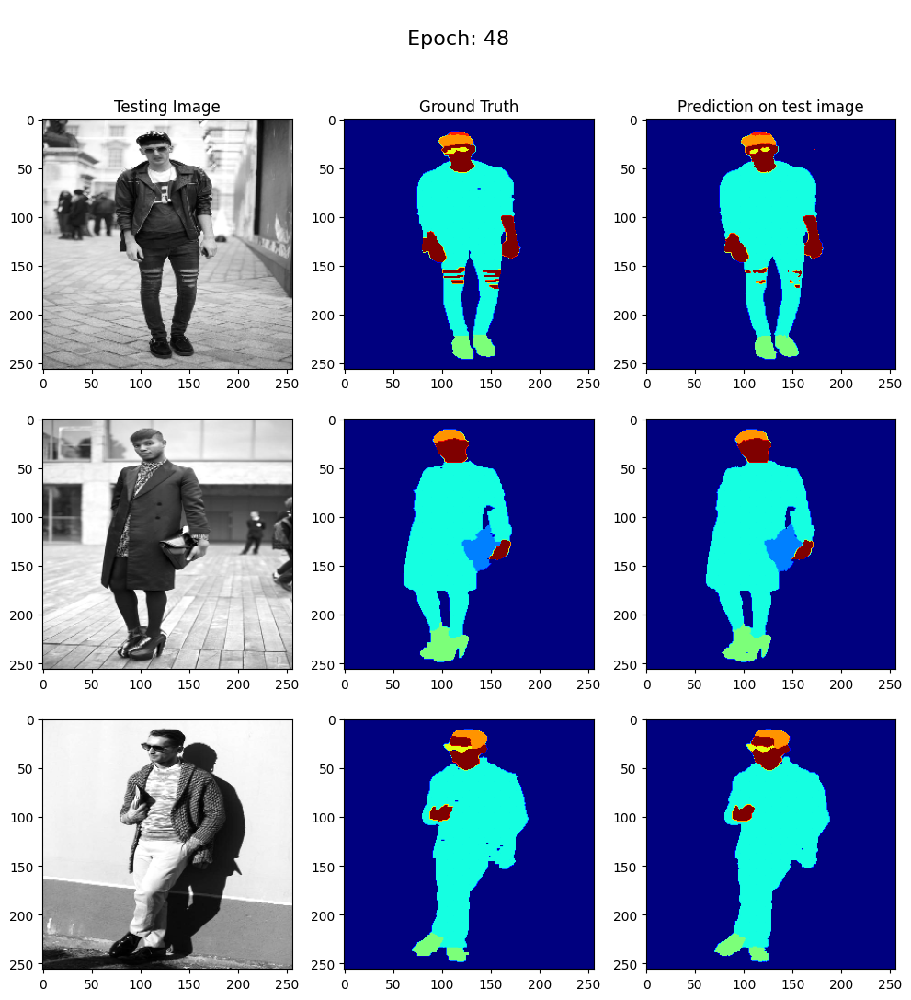


Sample Prediction after epoch 49

57/57 [==============================] - 10s 167ms/step - loss: 0.0147 - accuracy: 0.9943 - val_loss: 0.2246 - val_accuracy: 0.9567
Epoch 50/50
1/1 [==============================] - 0s 32ms/step


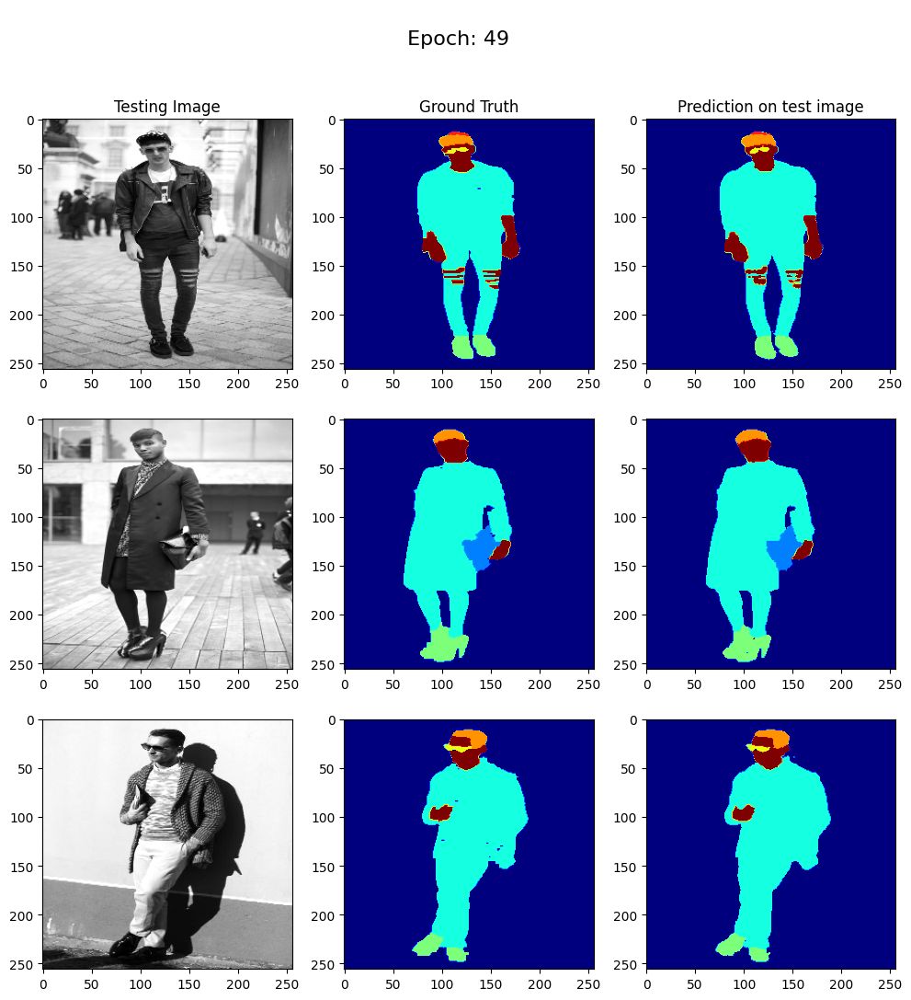


Sample Prediction after epoch 50

57/57 [==============================] - 10s 169ms/step - loss: 0.0143 - accuracy: 0.9945 - val_loss: 0.2263 - val_accuracy: 0.9560


In [43]:
EPOCHS = 50
VAL_SUBSPLITS = 5
BATCH_SIZE = 16
VALIDATION_STEPS = len(X_val)//BATCH_SIZE//VAL_SUBSPLITS
STEPS_PER_EPOCH = len(X_train)//BATCH_SIZE
# sample_image = train_images[0]
# sample_mask = train_masks[0]

class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        show_predictions(epoch)
        print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

model_history = model.fit(X_train, y_train, epochs=EPOCHS,
                           batch_size = BATCH_SIZE,
                          verbose=1,
                          #steps_per_epoch=STEPS_PER_EPOCH,
                          #validation_steps=VALIDATION_STEPS,
                          validation_data=(X_val, y_val),
                          callbacks=[DisplayCallback()]
                          )

In [44]:
model.save('/content/clothes_50')

/usr/local/lib/python3.10/dist-packages/keras/src/initializers/__init__.py:144: UserWarning: The `keras.initializers.serialize()` API should only be used for objects of type `keras.initializers.Initializer`. Found an instance of type <class 'tensorflow.python.ops.init_ops_v2.RandomNormal'>, which may lead to improper serialization.
  warnings.warn(


In [45]:
model = load_model('/content/clothes_50')

# Visualize Results

In [55]:
test_path = "/content/test_images"

test_paths = []

for imgname in os.listdir(test_path):
  test_paths.append(os.path.join(test_path,imgname))

1/1 [==============================] - 0s 26ms/step


<Axes: >

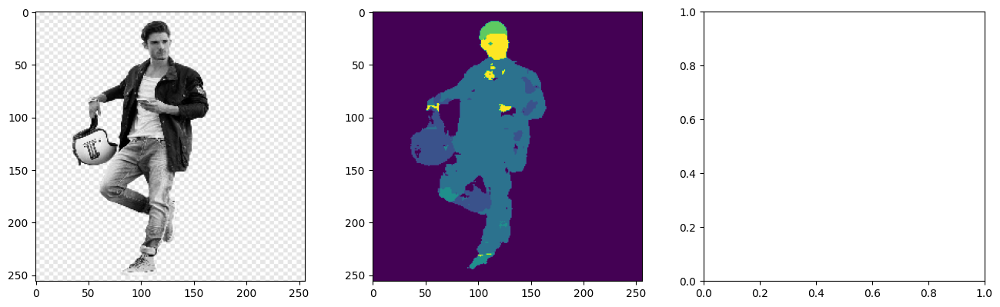

In [59]:
test_path = "/content/test_images"
timgnum = 0
#img_num = int(test_paths[timgnum].split("/")[-1].split(".")[0].split("_")[-1])

plt.figure(figsize=(16,10))

plt.subplot(2,3,1)
img = cv2.imread(test_paths[timgnum])
img = cv2.resize(img, (SIZE_Y, SIZE_X))
img = preprocessing(img)
plt.imshow(img)

plt.subplot(2,3,2)
pred = np.array(create_mask(model.predict(img[tf.newaxis, ...])))
plt.imshow(np.squeeze(pred))

plt.subplot(2,3,3)
#plt.imshow(train_masks[img_num-1])

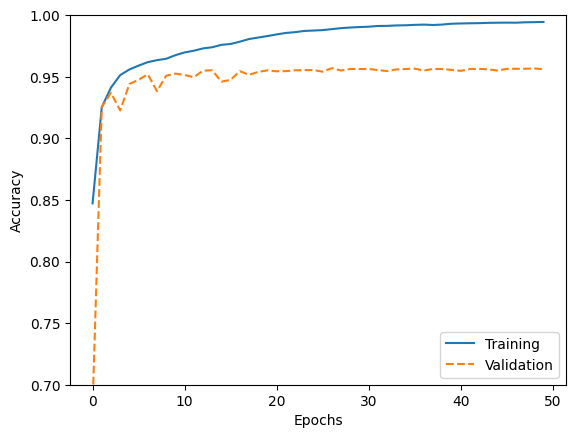

In [48]:
history_1 = model_history.history
acc=history_1['accuracy']
val_acc = history_1['val_accuracy']



plt.plot(acc[:150], '-', label='Training')
plt.plot(val_acc[:150], '--', label='Validation')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.ylim([0.7,1.0])
plt.legend()
plt.show()